# Foreword

This notebook computes the impact of coastal erosion risk in Madagascar under four future scenarios. The exposure types considered are:

- **Population**: The population affected by coastal erosion, for four future scenarios.
- **Economy**: The Gross Domestic Product (GDP) lost due to the direct effects of coastal erosion, for four future scenarios. The impact is expressed in USD and as a percentage of Madagascar's total GDP.

The four future scenarios considered are:

- **2050 SSP2-4.5**.
- **2050 SSP5-8.5**.
- **2085 SSP2-4.5**.
- **2085 SSP5-8.5**.

Population and economic impacts are computed at different administrative levels:

- **ADM0**: Country level.
- **ADM1**: Region level.
- **ADM2**: District level.
- **ADM3**: Commune level.
- **ADM4**: Fokontany level.

The main steps to follow in order to compute the coastal erosion risk in Madagascar for the mentioned scenarios and exposures are as follows:

1. **Preprocessing of the Administrative Boundaries of Madagascar**: Preparation of the polygons representing the administrative boundaries of Madagascar, for different administrative levels.
2. **Hazard preprocessing**: Computation of the polygons representing the eroded areas across Madagascar for the selected future scenarios.
3. **Exposure preprocessing**: Preprocessing of the population and economic exposure layers for Madagascar.
4. **Risk computation**: Overlay of the hazard and exposure layers to compute the future coastal erosion risk in terms of population and economic value affected in Madagascar.

A detailed description of the methodology and underlying assumptions for each step will be provided in their respective chapters. This script is designed to handle large datasets and perform computationally intensive geospatial operations efficiently. To achieve this, we utilize PostGIS for its robust geospatial processing capabilities. To ensure clarity and maintain a concise structure in this notebook, the Python functions used to execute each step are organized in a separate module that accompanies this notebook.

Below is a flowchart illustrating the various steps of the methodology employed in the script.

In [182]:
# Display flow chart of project methodology

from IPython.display import Image, display

image_path = '/Users/aprida/Documents/Consulting/Public_sector/GRMA_Madagascar/erosion/flowchart_erosion.png'
display(Image(filename=image_path))

# Import packages

In this section, we import the necessary packages and modules required for the analysis. The primary package being imported is utils, which contains the functions used throughout this notebook to compute the coastal erosion risk. These functions handle tasks like data loading, processing, and geospatial operations.

By importing everything from utils, all functions and classes defined in the module are accessible within the notebook. It's important to ensure that the utils.py file is in the same directory as this notebook or included in the Python path.

In [6]:
import utils
import importlib

# Reload the entire utils module
importlib.reload(utils)

# If you imported specific functions or variables, you might need to re-import them
from utils import *  # Re-import updated functions or variables if needed

# Set working directories

In this section, we define the root directory and subdirectory paths where input data and output results will be stored. It's important to set these directories so that the notebook can access and save files in the appropriate locations.

- **root**: The root directory contains all the necessary data files (e.g., shapefiles, raster files) and will be the base for accessing and saving various input/output files.
- **fn_figures**: This is a subdirectory within root dedicated to storing the figures and visualizations generated during the analysis, such as plots of the erosion risk results.

Make sure the directory paths are correctly set for your system before running the notebook.

In [7]:
root = '/Users/aprida/Documents/Consulting/Public_sector/GRMA_Madagascar'
fn_figures = '/Users/aprida/Documents/Consulting/Public_sector/GRMA_Madagascar/erosion/figures'
os.makedirs(fn_figures, exist_ok=True) # Create directory to save figures
erosion_dir = '/Users/aprida/Documents/Consulting/Public_sector/GRMA_Madagascar/erosion/liscoast'
os.makedirs(erosion_dir, exist_ok=True)
exposure_dir = '/Users/aprida/Documents/Consulting/Public_sector/GRMA_Madagascar/exposure'
os.makedirs(exposure_dir, exist_ok=True)

# Create PostGIS database

In this section, we create a PostGIS-enabled PostgreSQL database that will be used for spatial data operations. This database will allow us to store, process, and query geospatial data efficiently.

- **dbname**: Name of the database to be created (in this case, grma_madagascar).
- **dbuser**: Username used to authenticate with the PostgreSQL server.
- **dbpass**: Password for authenticating with the PostgreSQL server.
- **dbhost**: Host where the PostgreSQL server is located (e.g., localhost for local setup).
- **dbport**: Port number where the PostgreSQL server is running (typically 5432 for PostgreSQL).

This command triggers the create_pg_db function, which creates the PostgreSQL database with the PostGIS extension enabled, setting up the database for geospatial operations.

In [8]:
dbname = "grma_madagascar" # Add the name of your database
dbuser = "postgres"
dbpass = "postgres"
dbhost = "localhost"
dbport = "5432"
con = create_pg_db(dbname, dbuser, dbpass, dbhost, dbport)

createdb: error: database creation failed: ERROR:  database "grma_madagascar" already exists


In [25]:
scenarios = [
    'shd_ssp2_2050',
    'shd_ssp5_2050',
    'shd_ssp2_2085',
    'shd_ssp5_2085',
    'shd_ssp2_2100',
    'shd_ssp5_2100'
]

# Administrative boundaries (levels 0 to 4)

This section describes the steps to upload administrative boundaries (Level 4) into the PostGIS database, generate unified geometries for administrative levels 0 to 3, and visualize the administrative boundaries.

1. **Upload Administrative Boundaries Level 4 (vector file) to PostGIS database**: The first step in this section involves uploading a vector file of administrative boundaries (e.g. shapefile) into the PostGIS database. The uploaded data will be stored in a table named adm4.

2. **Generate geometries of Administrative Boundaries Level 0 to 3**: Next, the generate_adm_polygons function is used to generate aggregated geometries for administrative levels 0 to 4. These aggregated polygons are stored in a single table, mdg_adm4_geom, which is then used to create separate views for each administrative level (adm0 to adm3).

3. **Plot Administrative Boundaries levels 1 to 4**:The plot_adm function creates visualizations of the administrative boundaries for levels 1 to 4 (Regions, Districts, Communes, and Fokontany) using a basemap. These visualizations are saved as a figure in the specified directory.

VACUUM
Successfully uploaded adm4 to PostGIS database.


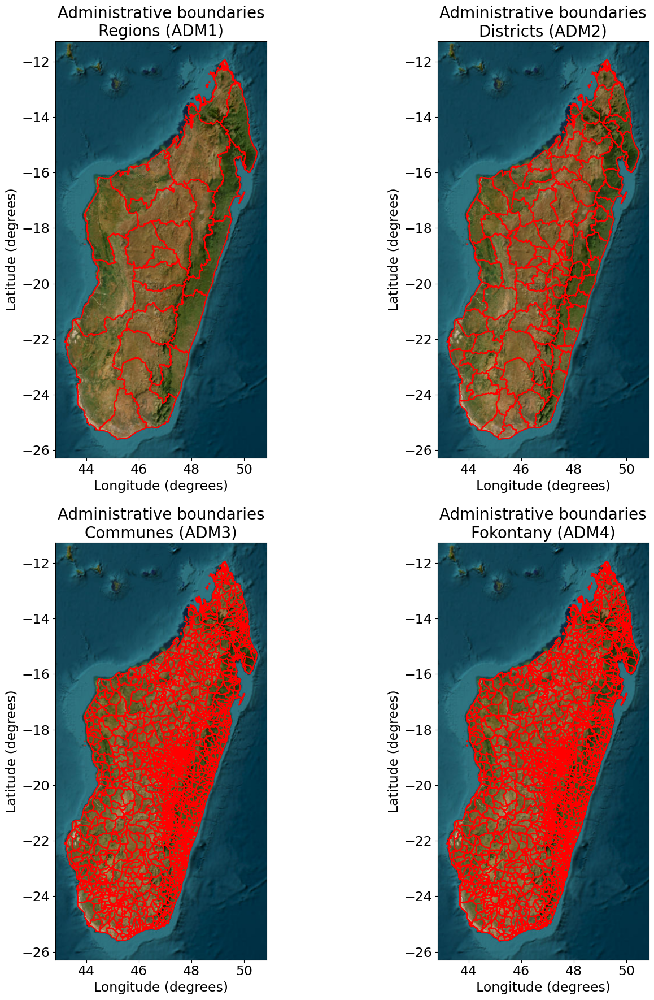

In [195]:
# 1. Upload Administrative Boundaries Level 4 (vector file) to PostGIS database
layer_name = 'geonode:mdg_admbnda_adm4_BNGRC_OCHA_20181031'
convert_to_multipolygon_and_upload_to_pg(layer_name, con, table_name='adm4')

# 2. Generate geometries of Administrative Boundaries Level 0 to 3
tn_adm4 = 'adm4'
tn_adm_all = 'mdg_adm4_geom'
generate_adm_polygons(tn_adm4, tn_adm_all, con)

# 3. Plot Administrative Boundaries levels 1 to 4
plot_adm(fn_figures, con)

# Hazard

5. Extraction of the Madagascar natural coastline**: 
6. **Extraction of LISCOAST global shoreline development dataset**: Extraction of the Large Scale Integrated Sea-level and Coastal Assessment Tool (European Commission, Joint Research Centre [JRC], 2019) dataset for the Madagascar Coastline. The LISCOAST dataset is a global shoreline change projection for sandy beaches. It provides metrics of shoreline position change (in meters) at approximately 500-meter intervals along the Malagasy coastline, indicating the change relative to a baseline reference shoreline. The total rates of shoreline development per scenario provided by LISCOAST are the sum of three phenomena:
    - **Ambient shoreline dynamics**, driven by long-term hydrodynamic, geological and anthropic factors, are estimated based on a 32-year analysis of satellite images (1984-2015).
    - **Shoreline retreat** due to coastal morphological adjustments to sea level rise (SLR) is estimated based on the equilibrium shoreline retreat of sandy coasts, which is derived from the Bruun rule (Bruun, 1962). This approach builds on the concept that beach morphology tends to adapt to the prevailing wave climate.
    - **Episodic erosion during extreme storms**, is simulated using the KD93 convolution erosion model, this focuses on the storm-induced shoreline retreat for 100-year return period storms (S100) and its difference (ΔS100) compared to present-day conditions.
7. **Validation of the LISCOAST dataset at national level** (details in the next sub-section).
8. **Computation of the polygons of eroded areas under the four future scenarios for Morondava** following a four-step method. The choice of Morondava is explained by the fact that, in 2018, BRGM collaborated with other partners in the development of a local coastal erosion hazard analysis at the coastal city of Morondava (central-west coast of Madagascar). This existing study will be leveraged for validation purposes (details in the next sub-section).
    - Extraction of the natural coastline of Morondava from OpenStreetMap to serve as the shoreline reference.
    - Generation of regular transects perpendicular to the identified coastline and identification of intersection points between the transects and the reference shoreline.
    - Geolocation of the position of the coastline under future scenarios using LISCOAST shoreline development rates and the OSM shoreline reference.
    - Connection of the identified future coastline points using interpolation algorithms to create the future coastline.
9. **Validation of the generated coastal erosion polygons using LISCOAST at Morondava** (details in the next sub-section).
10. **Computation of polygons of eroded areas under the four future scenarios for the entire Malagasy coast**.

## Download Madagascar Natural Coastline (OSM)

The shoreline development database used in this project is designed to analyze the future dynamics of Madagascar's coastline, specifically focusing on potential erosion or accretion in future scenarios.

Shoreline development, in this context, refers to the changes in the coastline over time—either through erosion (where the land retreats) or accretion (where the land expands due to the deposition of sediment). By understanding the current configuration of the coastline, we can model and assess how it might evolve under different climate and environmental scenarios.

Steps in this Process:

1. **Retrieve Madagascar's Country Boundary**: The administrative boundary (Level 0) of Madagascar, stored in a PostGIS database, is used to define the area of interest for shoreline analysis. The boundary polygon will be used as a reference for extracting coastline data from OpenStreetMap (OSM).
2. **Download the Coastline Data**: The OpenStreetMap (OSM) coastline data for Madagascar is extracted using specific OSM tags related to natural coastlines. The data represents the current state of the shoreline, which will serve as the baseline for future erosion or accretion scenarios.
3. **Process and Save the Coastline Data**: The coastline data is clipped to the boundaries of Madagascar and stored in the PostGIS database. This ensures that only the relevant portion of the coastline is used for analysis. A primary key is added to the coastline table for database integrity, and a spatial index is created for optimized geographic querying. An additional boolean column is added to classify each segment of the coastline as either part of the mainland or an island.
4. **(Optional) Plot the Coastline**: A map of Madagascar's coastline is generated and saved as an image for visual inspection. This map highlights the coastline features, and optionally, mainland areas, providing a visual context for future shoreline analysis.

/Users/aprida/opt/anaconda3/envs/hydromt-sfincs-hydromt-080/lib/python3.10/site-packages/geopandas/geodataframe.py:2377: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:4326
Right CRS: None

  return geopandas.clip(self, mask=mask, keep_geom_type=keep_geom_type)


VACUUM
 st_numgeometries 
------------------
                1
                4
(2 rows)

ALTER TABLE
madagascar_coastline saved to PostGIS database.


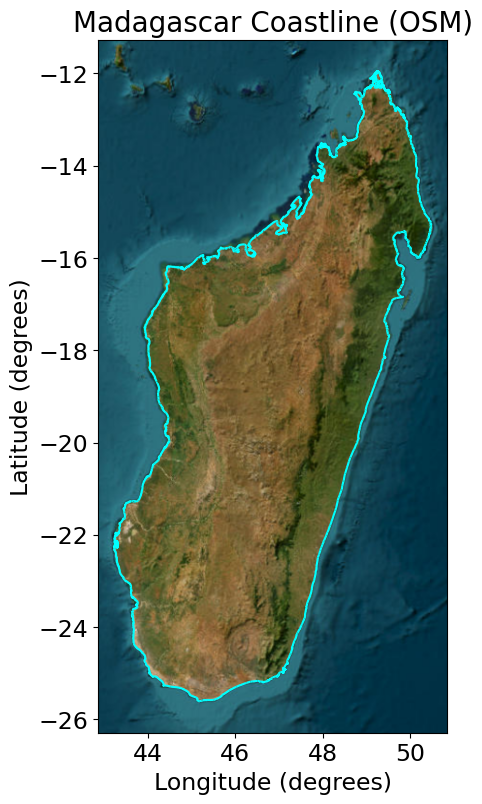

In [83]:
# Define the table containing the Madagascar country boundary (Level 0)
tn_country = 'mdg_adm0_geom'

# Call the function to compute the coastline of Madagascar and save the plot
compute_coastline(tn_country, fn_figures, con, plot=True)

In [ ]:
# Compute the polygon enclosed by the coastline of the mainland of Madagascar
aoi_name = 'madagascar' # PostGIS tables are tagged with lowercase to avoid need to query tables without adding quotes
compute_mainland_polygon(aoi_name, con)

## Download LISCOAST files

The following section downloads and processes the LISCOAST Global Erosion Projections Dataset. This dataset provides global projections of coastal erosion under various climate change scenarios.

The **download_liscoast()** function is used to automate the process of:
1. Downloading the dataset in ZIP format from the LISCOAST repository.
2. Extracting and renaming files to align with SSP-based climate scenarios.
3. Filtering the dataset to include only the area of interest (AOI) defined by a PostGIS table.
4. Saving the processed data to a PostGIS database with optimized indexing and spatial metadata.
5. Assigning additional attributes to the processed data for further analysis, such as:
   - Identifying whether points belong to the mainland or islands.
   - Ordering points along the mainland coastline based on spatial proximity.

In [ ]:
tn_country = 'mdg_adm0_geom'
download_liscoast(erosion_dir, tn_country, con)

The **compute_liscoast_2085()** function generates shoreline development (SHD) projections for the year 2085 by linearly interpolating between the SHD values for 2050 and 2100. It processes data for two Shared Socioeconomic Pathways (SSP) scenarios (ssp2 and ssp5) and saves the interpolated results as new tables (shd_ssp2_2085 and shd_ssp5_2085) in the PostGIS database. These tables contain geospatial data with attributes such as interpolated SHD values, mainland status, and spatial ordering, enabling detailed coastal analysis for 2085.

In [95]:
compute_liscoast_2085(con)

shd_ssp2_2085 saved to PostGIS database.
shd_ssp5_2085 saved to PostGIS database.


The **plot_liscoast()** function generates a grid of subplots to visualize the shoreline development (SHD) data for multiple scenarios, each representing a future time horizon. The function queries the shoreline development data from a PostGIS database and plots the SHD values as points, using a color map to represent the displacement in meters. It adds a basemap for geographic context and saves the resulting plot as a PNG image.

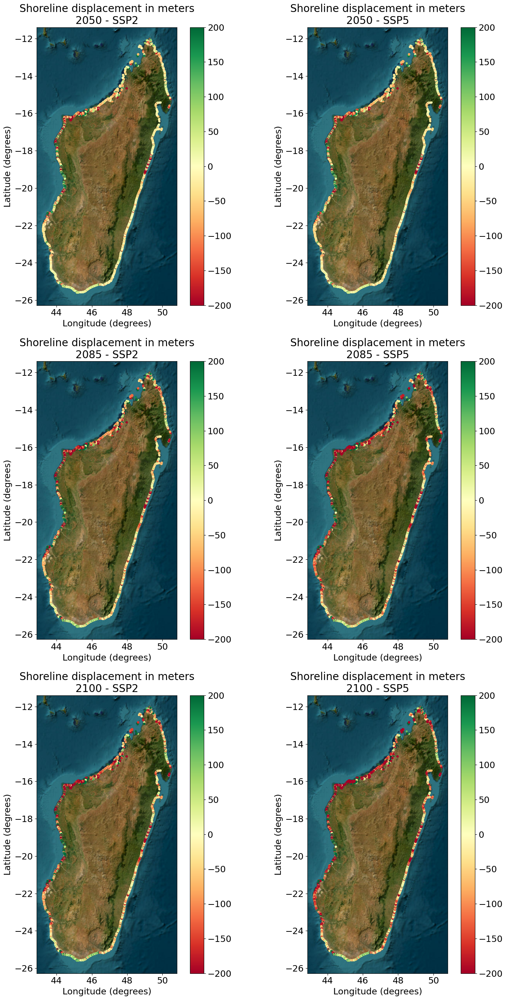

In [97]:
plot_liscoast(scenarios, fn_figures, con)

## Compute shoreline development points along transect per scenario

This function computes and stores shoreline development (SHD) points along the coastline for each defined scenario. It shifts the points along a transect perpendicular to the coastline based on the shoreline displacement value (`shd_50perc`). The shifted points are then saved in a new table for each scenario, providing information such as the distance to the nearest coastline, displacement value, and geometry.

In [102]:
compute_shd_points(scenarios, con)

shd_ssp2_2050_points saved to PostGIS database.
shd_ssp5_2050_points saved to PostGIS database.
shd_ssp2_2085_points saved to PostGIS database.
shd_ssp5_2085_points saved to PostGIS database.
shd_ssp2_2100_points saved to PostGIS database.
shd_ssp5_2100_points saved to PostGIS database.


## Compute polygon of shoreline development for future scenarios

This function computes polygons representing shoreline segments based on the grouping of shoreline development points. Consecutive points along the coastline are grouped together if their distance to the next and previous points is shorter than a specified distance d. The function generates these polygons and stores them in the PostGIS database for further spatial analysis.

In [104]:
tn_input_coastline = 'madagascar_coastline_mainland'
d = 1000 # Maximum distance in meters between consecutive points to belong to same group of points
compute_shd_polygons(tn_input_coastline, scenarios, d, con)

shd_ssp2_2050_pol saved to PostGIS database.
shd_ssp5_2050_pol saved to PostGIS database.
shd_ssp2_2085_pol saved to PostGIS database.
shd_ssp5_2085_pol saved to PostGIS database.
shd_ssp2_2100_pol saved to PostGIS database.
shd_ssp5_2100_pol saved to PostGIS database.


## Compute Erosion Statistics at Administrative Levels

This function computes the total area affected by coastal erosion for each administrative level (ADM4 to ADM0). It assigns shoreline development polygons to the corresponding administrative units (such as regions, districts, communes, and fokontany) based on their spatial intersection. The function calculates the area of each administrative unit affected by erosion and stores the results in a new table in the PostGIS database.

In [113]:
tn_adm = 'adm4'
compute_erosion_adm(scenarios, tn_adm, con)

## Plot Erosion Statistics at Administrative Levels

This function visualizes the erosion statistics calculated for each scenario and administrative level. It generates maps showing the area affected by erosion at different administrative levels (Regions, Districts, Communes, Fokontany), and saves these visualizations as PNG files in a specified directory. The maps display the spatial distribution of erosion, with color coding representing the magnitude of the affected area (in hectares).

Coastal area eroded (2050 - SSP2): 12278.25 ha.


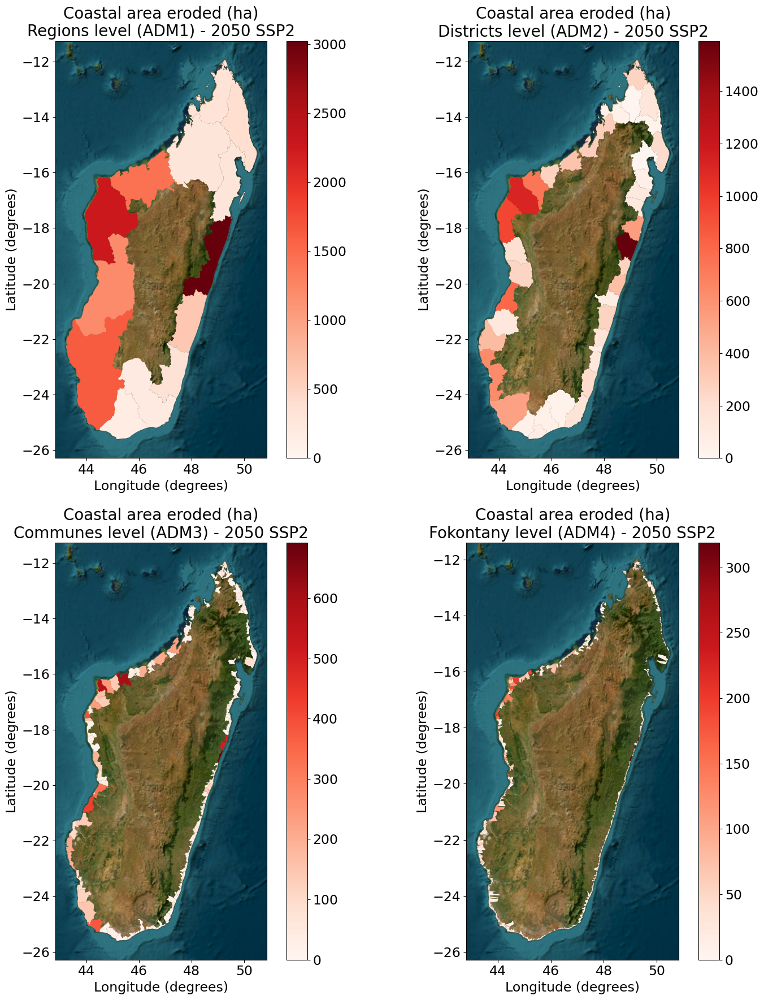

Coastal area eroded (2050 - SSP5): 13178.98 ha.


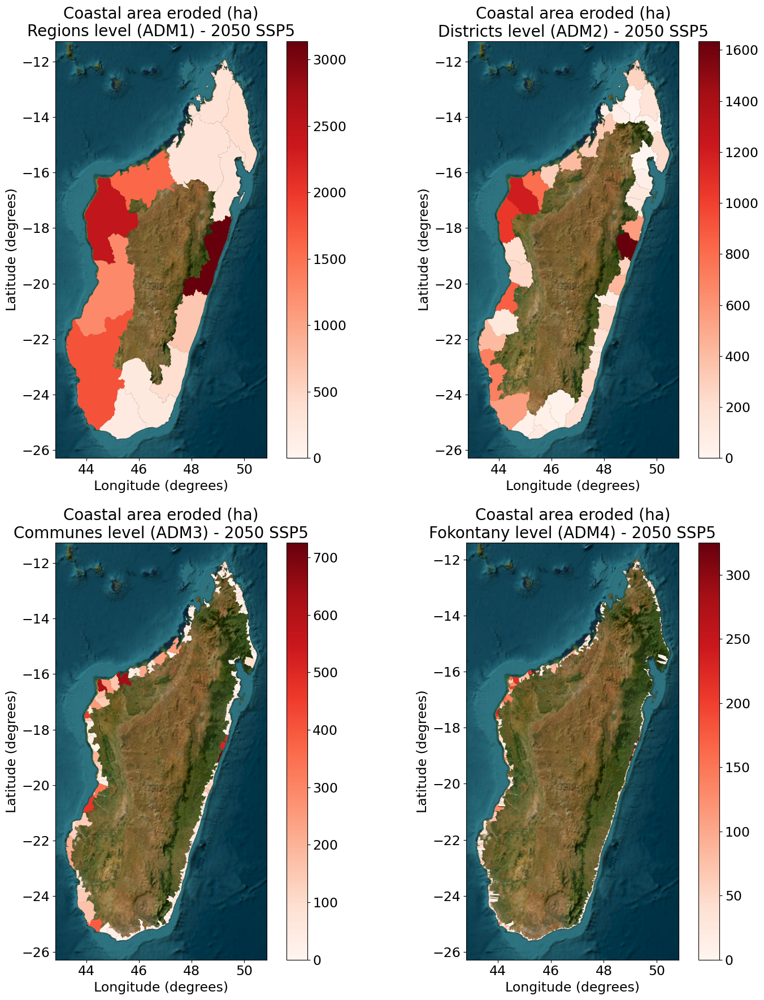

Coastal area eroded (2085 - SSP2): 22432.6 ha.


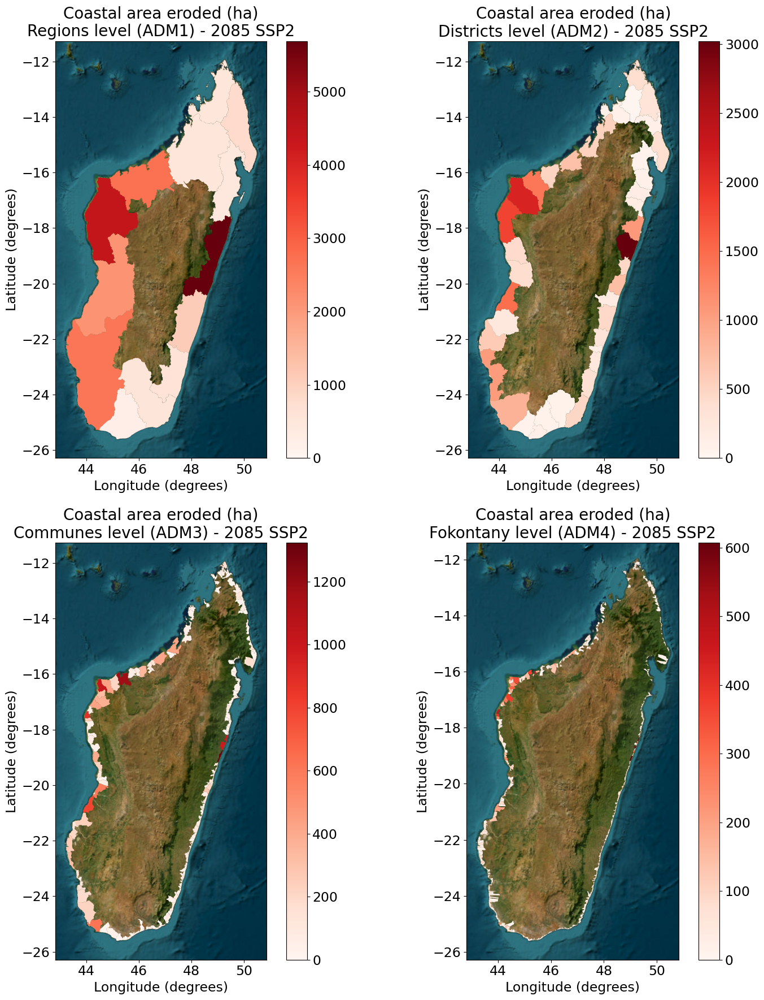

Coastal area eroded (2085 - SSP5): 26828.59 ha.


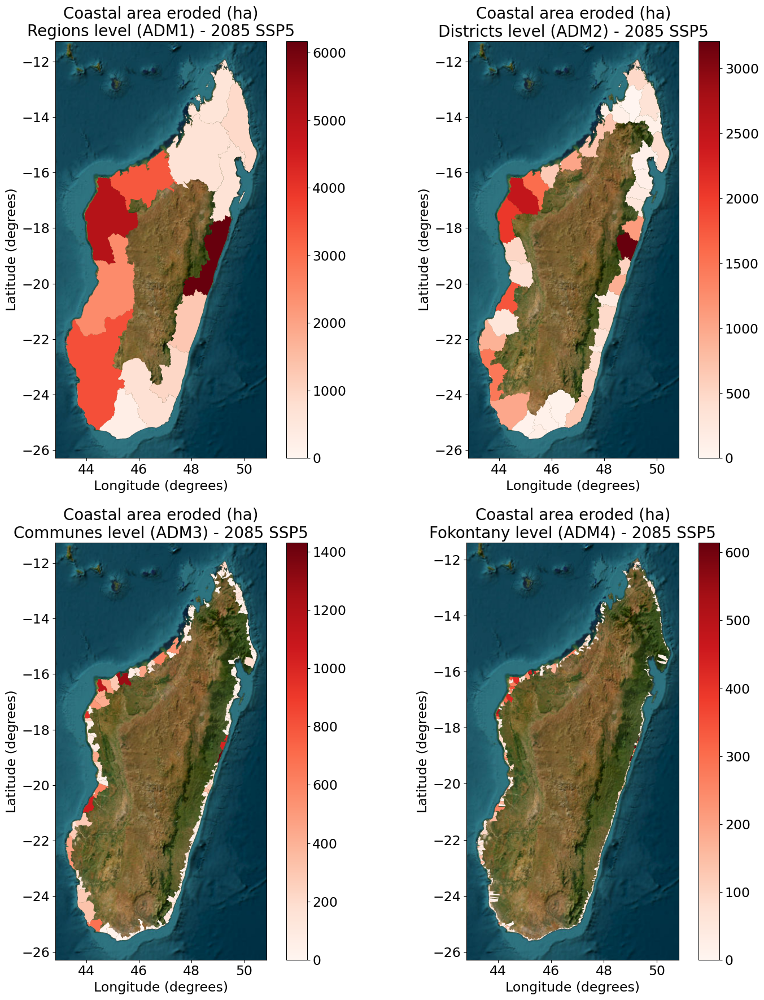

Coastal area eroded (2100 - SSP2): 26673.85 ha.


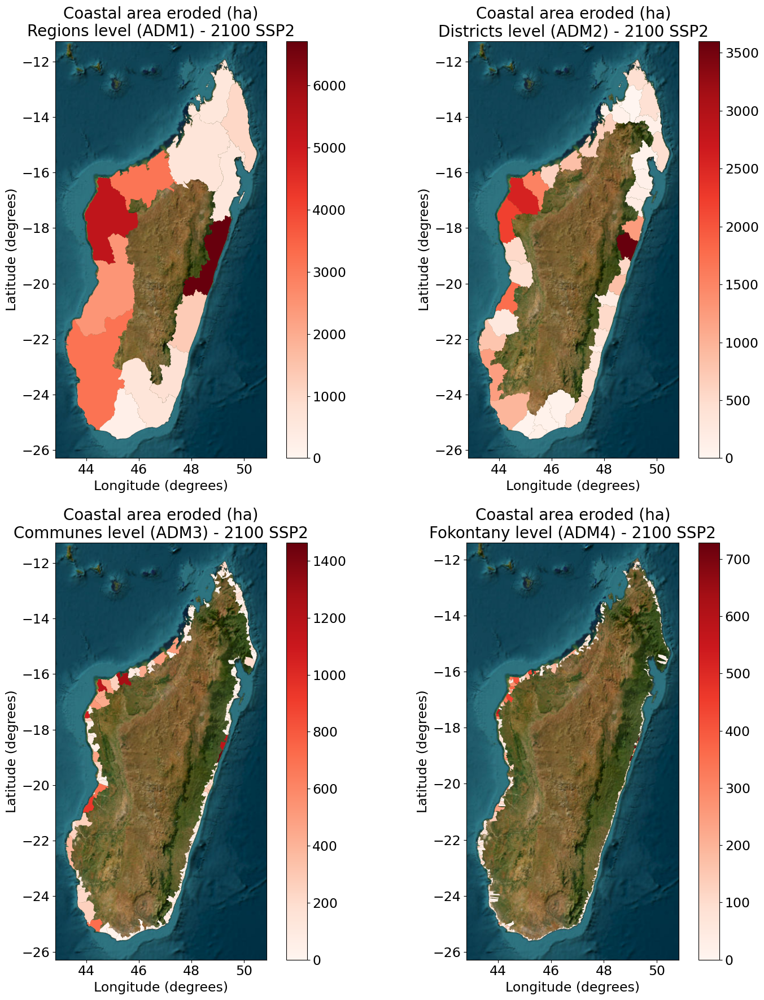

Coastal area eroded (2100 - SSP5): 32655.61 ha.


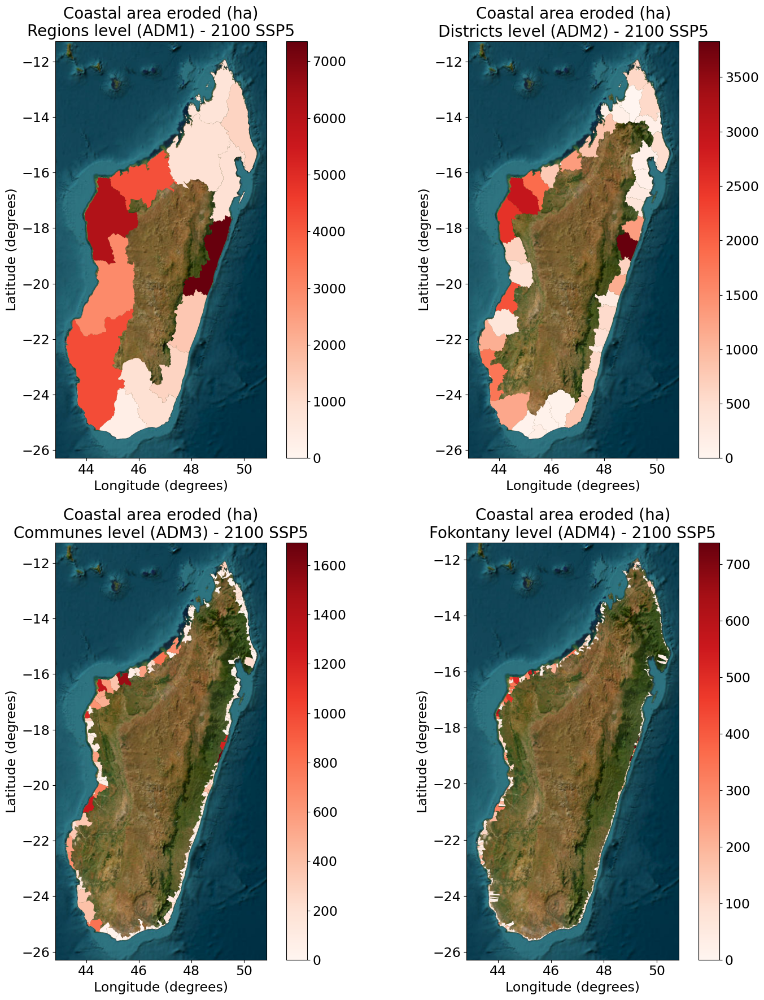

In [116]:
plot_erosion_adm(scenarios, fn_figures, con)

## Coastal Erosion Evolution in Madagascar for Future Scenarios

This section visualizes the overall evolution of coastal area erosion in Madagascar under future scenarios. The script calculates the eroded area for different SSPs (Shared Socioeconomic Pathways) and thresholds (e.g., 2050 and 2085). It then generates a bar plot to compare the eroded area for each scenario over time.

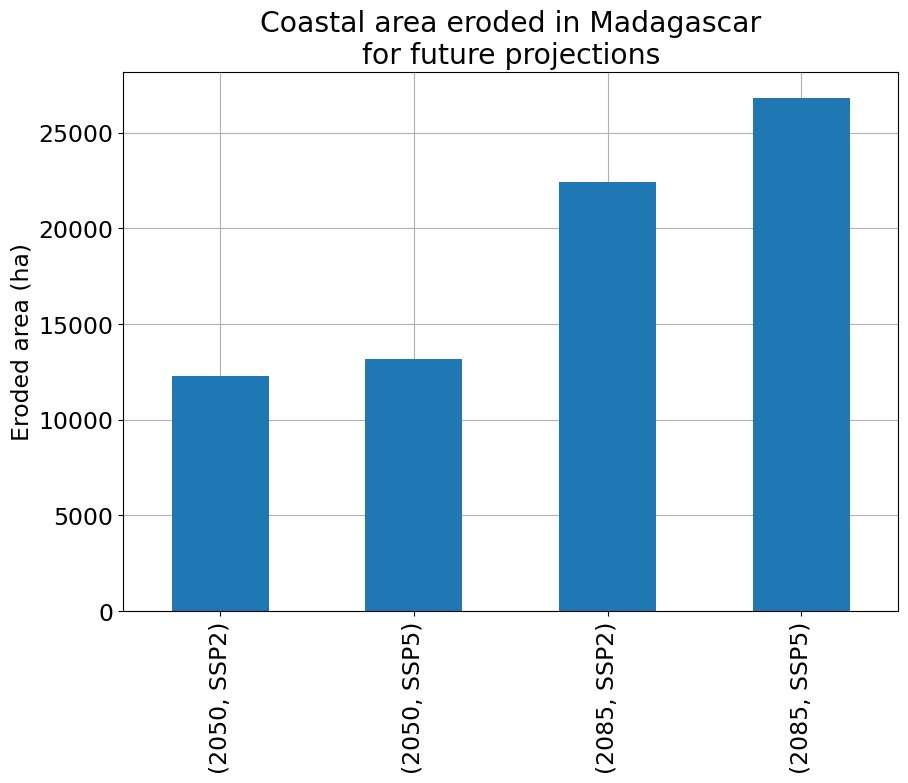

In [121]:
plot_coastal_erosion_evolution(scenarios, con, fn_figures)

## Top 8 Most Eroded Communes in Madagascar for Future Scenarios

This section highlights the communes in Madagascar that are projected to experience the largest coastal erosion under future scenarios. The analysis is based on erosion projections for SSPs (Shared Socioeconomic Pathways) and thresholds (e.g., 2050 and 2085). Two outputs are generated:

1. **Spatial Map**: A visualization of the geographical location of the top 8 most eroded communes.
2. **Bar Plot**: A comparison of the eroded areas for these communes across different scenarios.

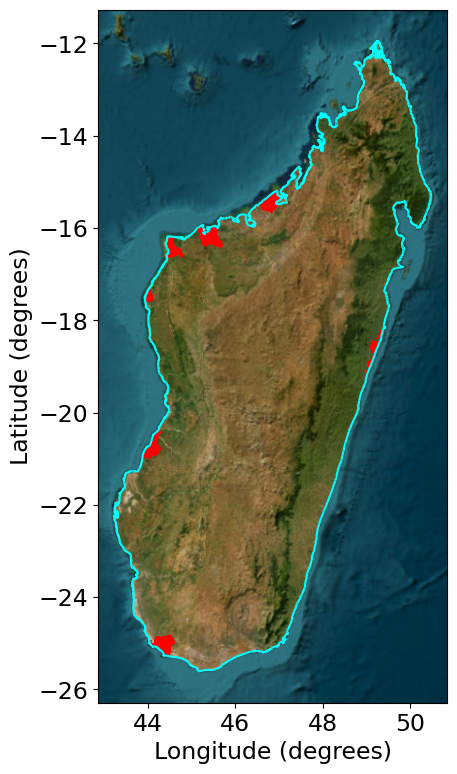

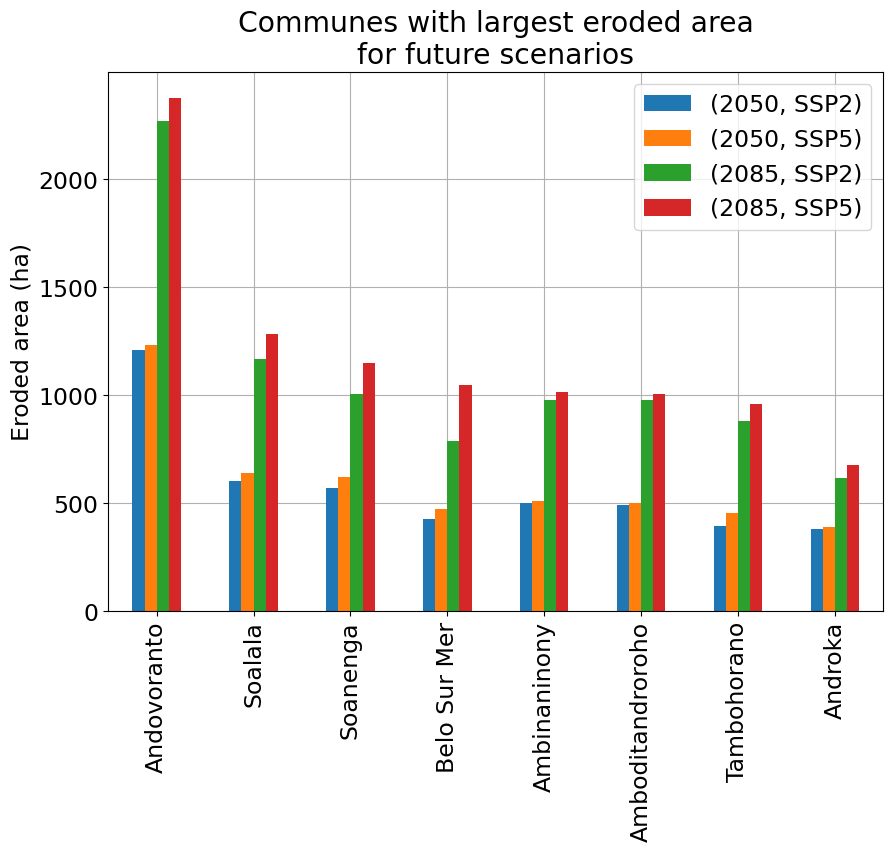

In [125]:
plot_most_eroded_communes(scenarios, con, fn_figures)

## Hazard validation

The **compute_shd_segments()** function calculates shoreline displacement (SHD) values along discrete segments of the coastline for multiple scenarios (e.g., SSP pathways). It processes the coastline geometry, splits it into segments of length d meters, and computes average erosion values (SHD) along these segments. The results are then saved to a PostGIS database, where each segment's SHD value is stored for further analysis.

In [99]:
tn_input = 'madagascar_coastline_mainland'
d = 10820 # Meters
compute_shd_segments(scenarios, tn_input, d, con)

shd_ssp2_2050_segments saved to PostGIS database.
shd_ssp5_2050_segments saved to PostGIS database.
shd_ssp2_2085_segments saved to PostGIS database.
shd_ssp5_2085_segments saved to PostGIS database.
shd_ssp2_2100_segments saved to PostGIS database.
shd_ssp5_2100_segments saved to PostGIS database.


# Exposure

## Population Exposure

This section focuses on preparing and visualizing population exposure data. 
We process raster population data, assign population to administrative boundaries, and generate visualizations of population exposure per administrative level.

Steps:
1. **Polygonize Population Raster:**
   Converts the input population raster data into vector polygons to enable further spatial analysis.
2. **Compute Population per Administrative Boundary:**
   Assigns population polygons to administrative boundaries (ADM0 to ADM4) and calculates weighted population exposure.
3. **Visualize Population Exposure:**
   Plots population exposure statistics for different administrative levels using subplots and maps.


0...10...20...30...40...50...60...70...80...90...100 - done.
CREATE INDEX
VACUUM
30807010.0
30807011.0
30807002.0
30806960.0


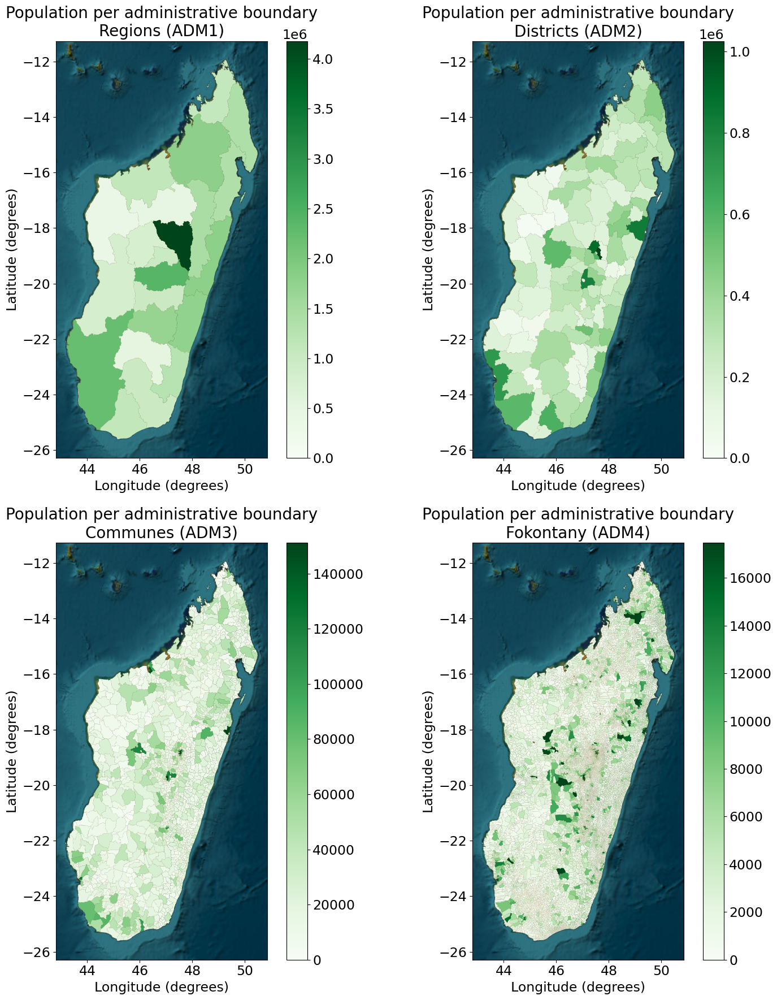

In [136]:
# Input raster file containing population data
fn_input = '/Users/aprida/Downloads/Madagascar_2024_pop_projWP.tif'

# Output table to store polygonized population data
tn_output = 'population_worldpop'

# Convert population raster to polygons and upload to the database
polygonize_population(fn_input, tn_output, con)

# Table containing population polygons
tn_population = 'population_worldpop'

# Table containing administrative boundaries
tn_adm = 'adm4'

# Compute population exposure per administrative level (ADM0 to ADM4)
compute_population_adm(tn_population, tn_adm, con)

# Directory to save output figures
plot_population_adm(fn_figures, con)

## Economic Value Exposure

This section outlines the steps for downloading, processing, and visualizing economic value (GDP) data. The workflow involves the following key steps:
1. **Download Economic Value Data**: Fetch GDP data for selected countries at a specified resolution and year.
2. **Polygonize Economic Value Raster**: Convert raster data (GeoTIFF) into vector polygons for spatial analysis.
3. **Compute Economic Value by Administrative Boundaries**: Aggregate economic value data at different administrative levels.
4. **Visualize and Save Economic Value**: Generate and save visualizations of economic value distributions across regions.

In [ ]:
download_econ_value(exposure_dir, countries='MDG', res_arcsec=15, exponents=(0,1), fin_mode='gdp', reference_year=2020)

# Polygonize raster of economic value (GDP)
fn_input = '/Users/aprida/Documents/Consulting/Public_sector/GRMA_Madagascar/exposure/econ_value_litpop_mdg_15arcsec_exp01_gdp_2020.tif'
polygonize_econ_value(fn_input, con)

# Compute population per administrative boundary and for levels 0 to 4
tn_econ_value = 'econ_value_litpop'
tn_adm = 'adm4'
compute_econ_value_adm(tn_econ_value, tn_adm, con)
plot_econ_value_adm(fn_figures, con)

# Risk Assessment

## Population at Coastal Erosion Risk

This section outlines the steps for analyzing populations at risk due to coastal erosion under various future scenarios. The workflow involves the following key steps:

1. **Compute Population Affected by Erosion**: Identify and calculate the population affected by coastal erosion at the country level for each scenario.
2. **Aggregate Population Erosion Statistics by Administrative Level**: Group and summarize population erosion data by administrative boundaries.
3. **Add Spatial Geometries to Population Statistics**: Attach spatial geometries to population statistics for visualization.
4. **Visualize Population at Risk disaggregated per Administrative Boundary)**: Generate and save visualizations of population at risk for each scenario and administrative level.
5. **Visualize Population at Risk at country scale**: Generates a plot showing the population counts adn the % of population at risk in the whole country for each future scenario. This enables to understamd the increase in coastal erosion risk under future scenarios.
6. **Visualize Population Erosion Risk at Commune Level**: Focus on the top communes most affected by coastal erosion for each scenario and create detailed bar plots.

shd_ssp2_2050_pop_erosion saved to PostGIS database.
shd_ssp5_2050_pop_erosion saved to PostGIS database.
shd_ssp2_2085_pop_erosion saved to PostGIS database.
shd_ssp5_2085_pop_erosion saved to PostGIS database.
shd_ssp2_2100_pop_erosion saved to PostGIS database.
shd_ssp5_2100_pop_erosion saved to PostGIS database.
shd_ssp2_2050_pop_erosion_adm_stats saved to PostGIS database.
shd_ssp5_2050_pop_erosion_adm_stats saved to PostGIS database.
shd_ssp2_2085_pop_erosion_adm_stats saved to PostGIS database.
shd_ssp5_2085_pop_erosion_adm_stats saved to PostGIS database.
shd_ssp2_2100_pop_erosion_adm_stats saved to PostGIS database.
shd_ssp5_2100_pop_erosion_adm_stats saved to PostGIS database.


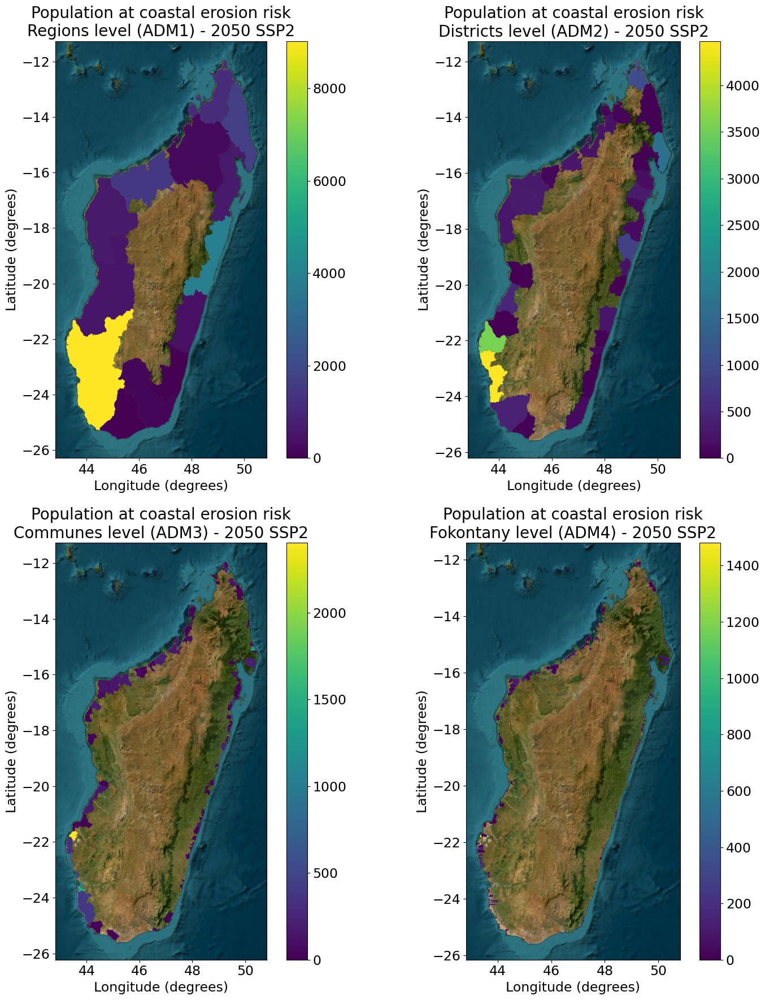

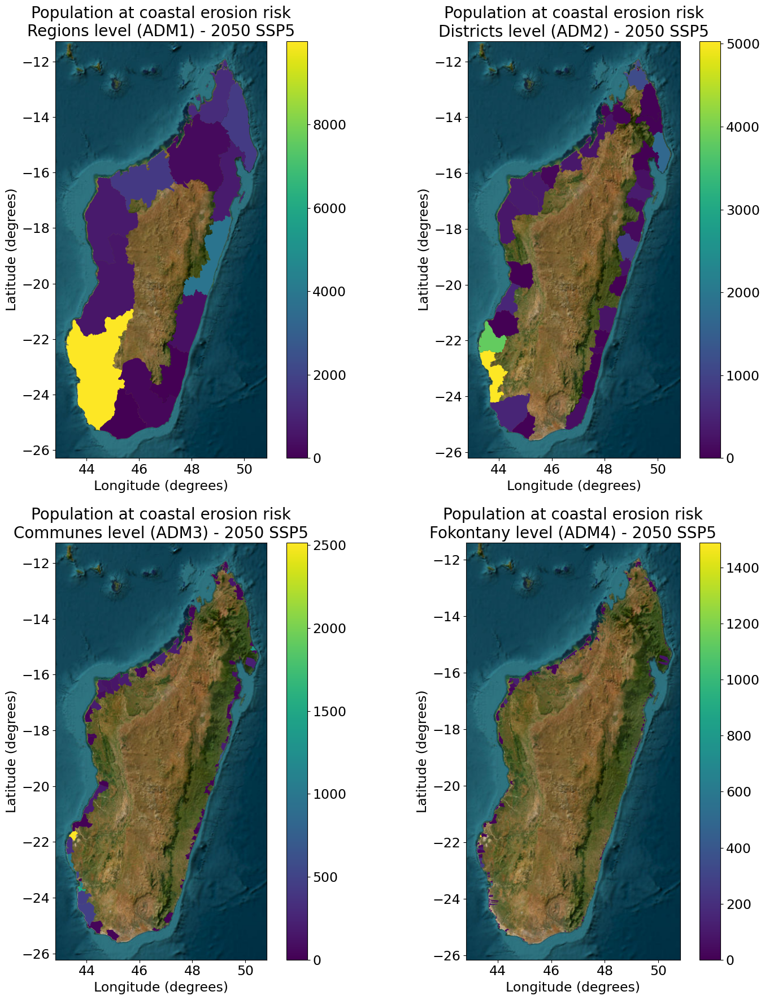

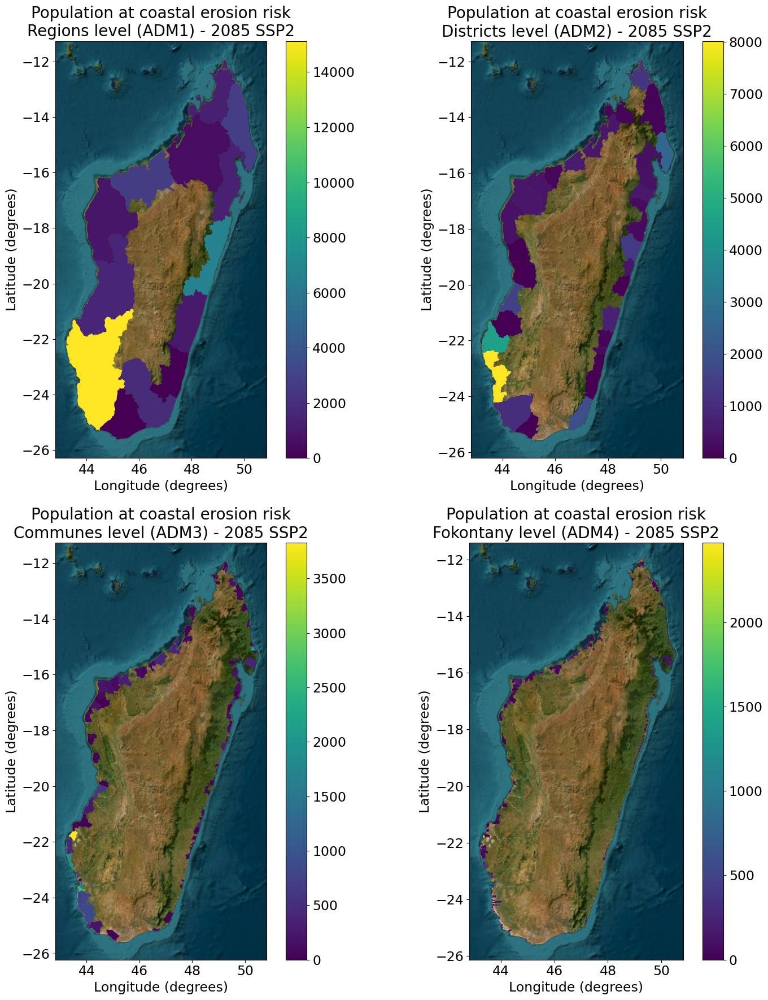

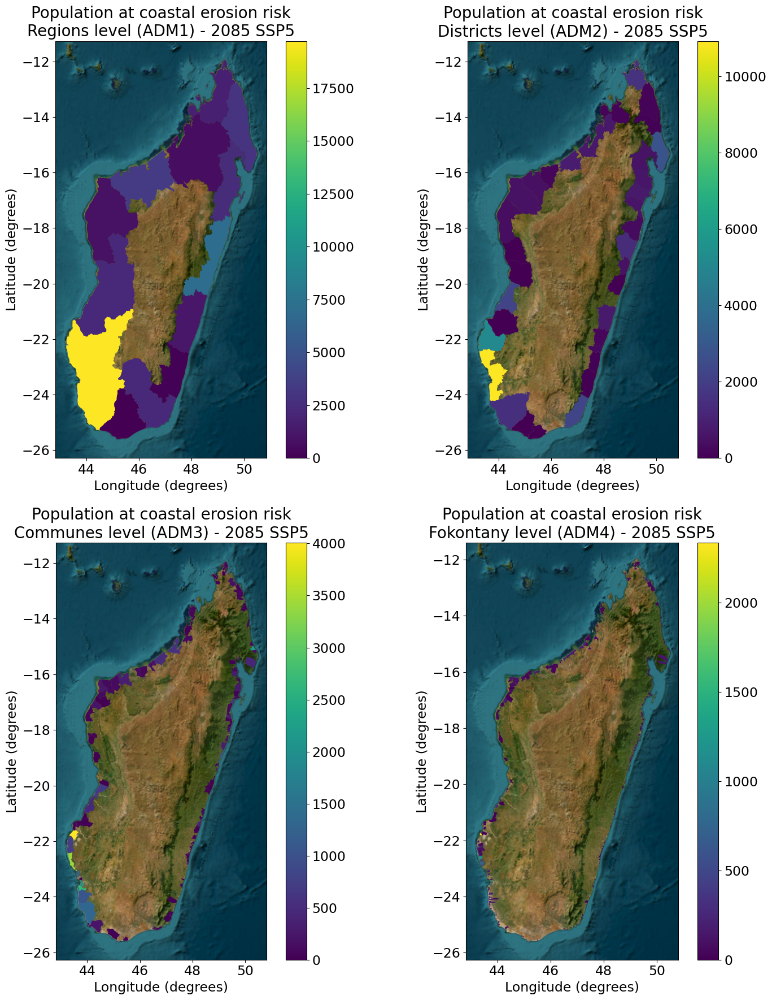

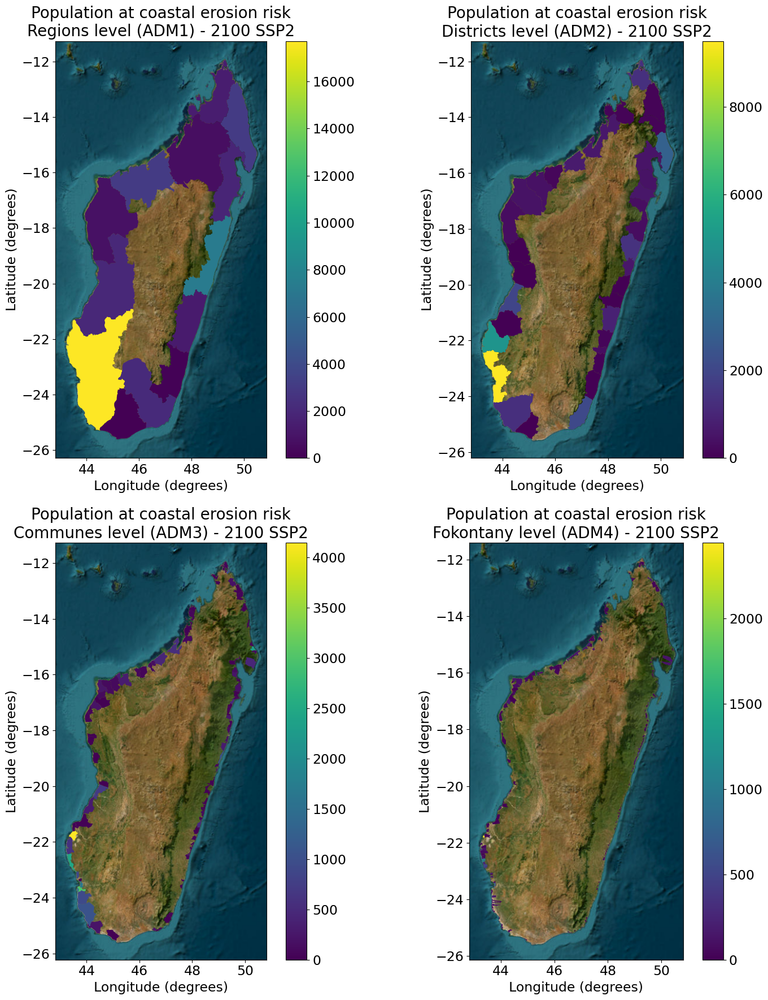

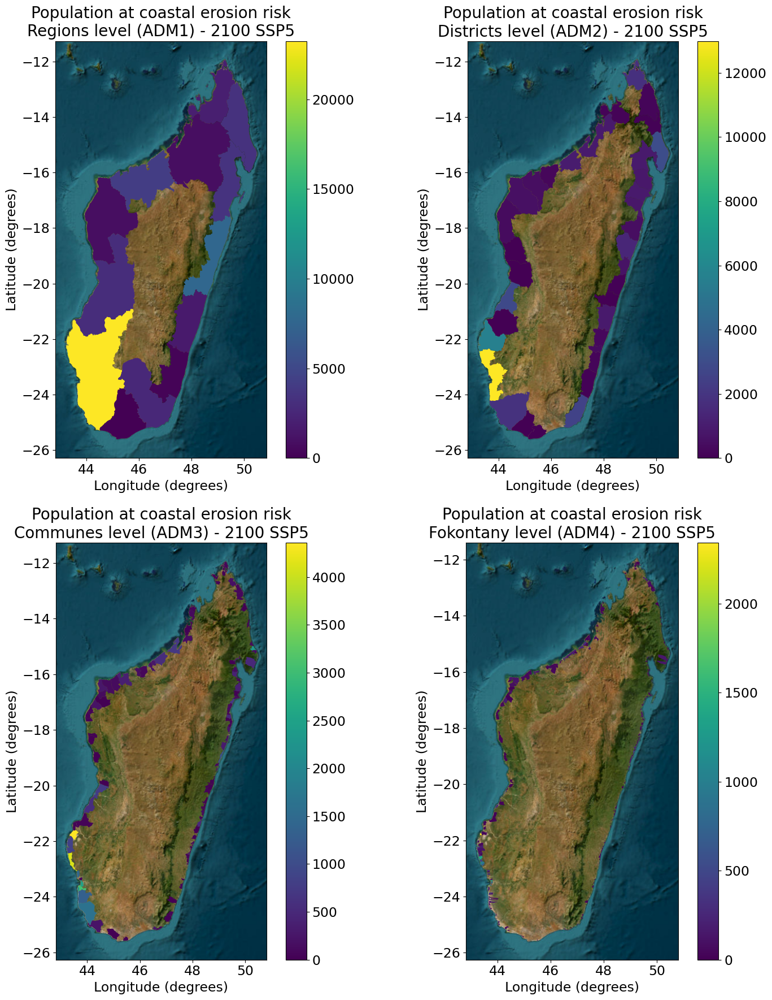

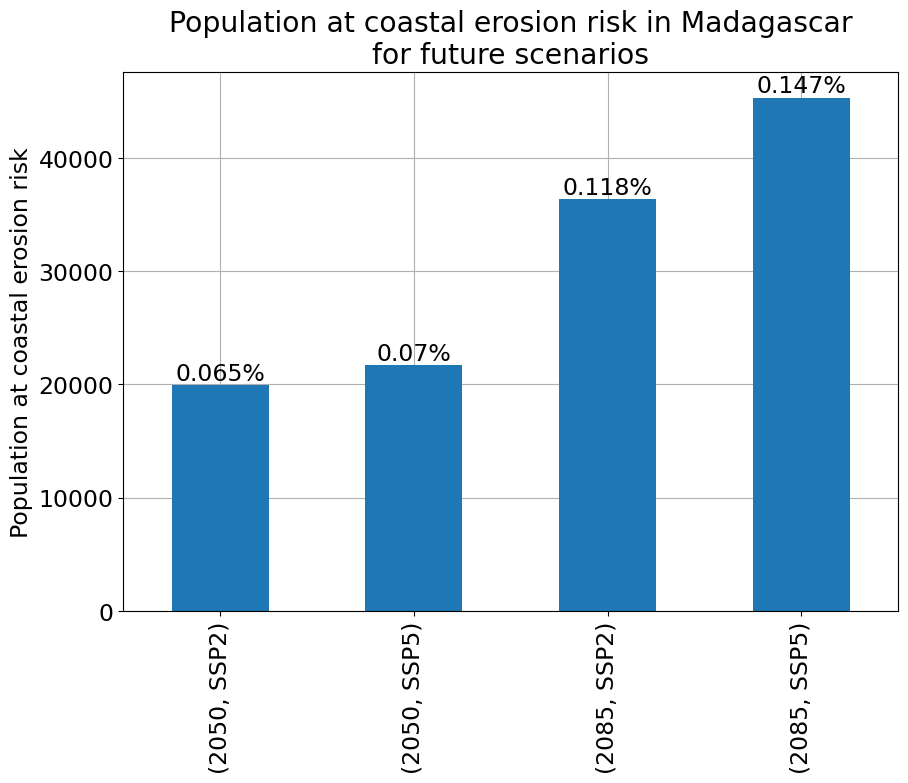

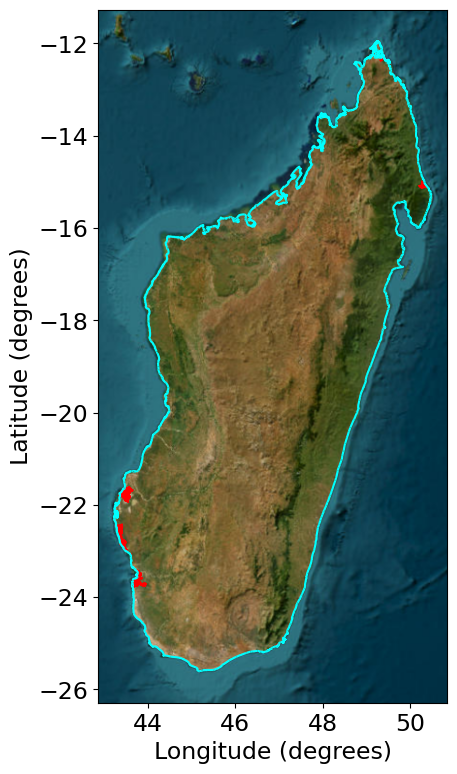

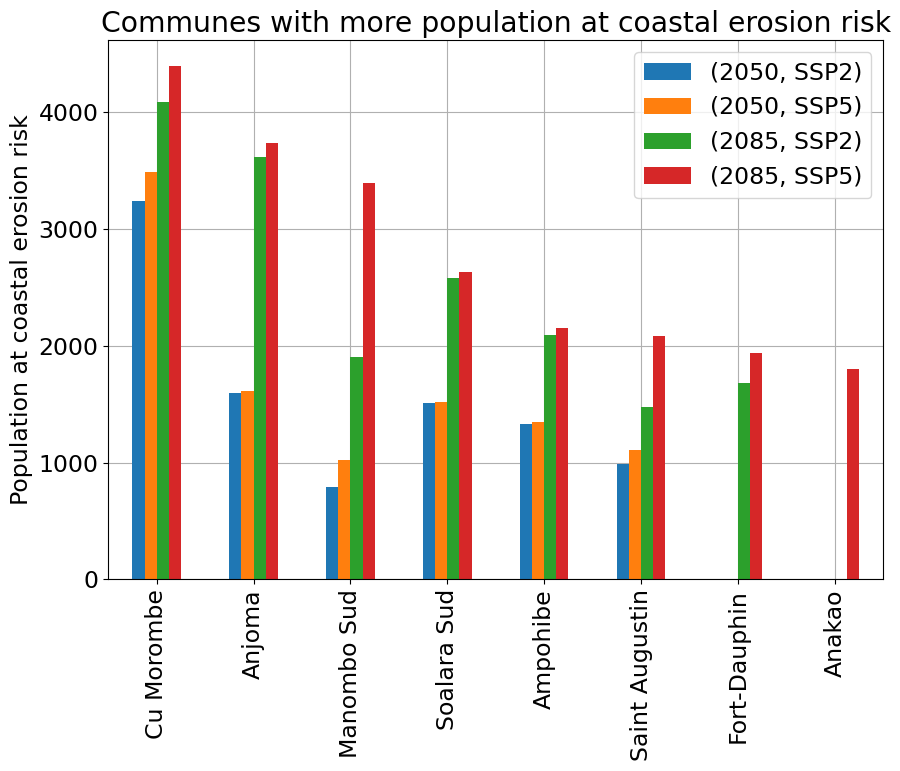

In [176]:
# Define the population data source.
# The variable `tn_input_pop` specifies the name of the input table containing population data.
tn_input_pop = 'population_worldpop'

# Step 1: Compute population affected by erosion.
# This function processes the erosion impact for the given population data (`tn_input_pop`)
# across all specified scenarios (`scenarios`). It creates a summary table for each scenario.
compute_population_eroded(tn_input_pop, scenarios, con)

# Step 2: Compute population affected by erosion at various administrative levels.
# This function aggregates population erosion impact statistics for each administrative level
# (adm0 to adm4) across the specified scenarios. Results are saved as separate tables.
compute_population_eroded_adm(scenarios, con)

# Step 3: Add spatial geometries to population erosion statistics.
# This function joins population erosion statistics with spatial geometry tables for
# each administrative level (adm0 to adm4), enabling geospatial visualization.
compute_population_eroded_adm_geometries(scenarios, con)

## Visualization of Population Risk

# Step 4: Plot population erosion risk maps for each scenario and administrative level.
# This function generates visualizations showing population at risk for each future scenario
# and administrative level. The resulting maps are saved as PNG files in the specified directory (`fn_figures`).
plot_population_eroded_adm(scenarios, fn_figures, con)

# Step 5: Plot showing the population counts adn the % of population at risk in the whole country for each future scenario.
# This enables to understamd the increase in coastal erosion risk under future scenarios.
plot_population_eroded_country(scenarios, fn_figures, con)

# Step 6: Plot showing the communes with highest population at coastal erosion risk and their location in the map.
plot_population_eroded_communes(scenarios, fn_figures, con)

## Economic value at Coastal Erosion Risk

This section outlines the steps for analyzing the economic value at risk due to coastal erosion under various future scenarios. The workflow involves the following key steps:

1. **Compute Economic Value Affected by Erosion**: Identify and calculate the economic value at risk from coastal erosion across different future scenarios. This step processes the data and computes the overall economic loss for each scenario.
2. **Aggregate Economic Value Erosion Statistics by Administrative Level**: Group and summarize the economic value erosion data at various administrative levels (e.g., country, regions, communes). This helps to understand the economic impact across different geographical areas.
3. **Add Spatial Geometries to Economic Value Statistics**: Attach spatial geometries (e.g., shapefiles) to the aggregated economic value statistics at each administrative level. This step enables the visualization of the affected areas and their respective economic values.
4. **Visualize Economic Value at Risk per Administrative Level**: Generate and save visualizations showing the economic value at risk due to coastal erosion for each administrative level across different future scenarios. These visualizations help to identify the areas with the highest economic exposure to coastal erosion.
5. **Visualize Economic Value at Risk at Country Scale**: Generate a plot displaying the total economic value at risk at the national scale. This visualization shows the overall economic risk for the entire country and highlights changes in the risk levels across future scenarios. It allows decision-makers to understand the national economic impact due to coastal erosion in the future.
6. **Visualize Economic Value Erosion Risk at Commune Level**: Focus on the communes most affected by coastal erosion for each future scenario. This step involves creating detailed visualizations that highlight the top communes based on the economic value at risk, enabling a more granular understanding of the economic threats at the local level.

shd_ssp2_2050_econ_value_erosion
shd_ssp5_2050_econ_value_erosion
shd_ssp2_2085_econ_value_erosion
shd_ssp5_2085_econ_value_erosion
shd_ssp2_2100_econ_value_erosion
shd_ssp5_2100_econ_value_erosion
shd_ssp2_2050_econ_value_erosion_adm_stats saved to PostGIS database.
shd_ssp5_2050_econ_value_erosion_adm_stats saved to PostGIS database.
shd_ssp2_2085_econ_value_erosion_adm_stats saved to PostGIS database.
shd_ssp5_2085_econ_value_erosion_adm_stats saved to PostGIS database.
shd_ssp2_2100_econ_value_erosion_adm_stats saved to PostGIS database.
shd_ssp5_2100_econ_value_erosion_adm_stats saved to PostGIS database.
Economic value at coastal erosion risk (2050 - SSP2): 2002369.0 USD.


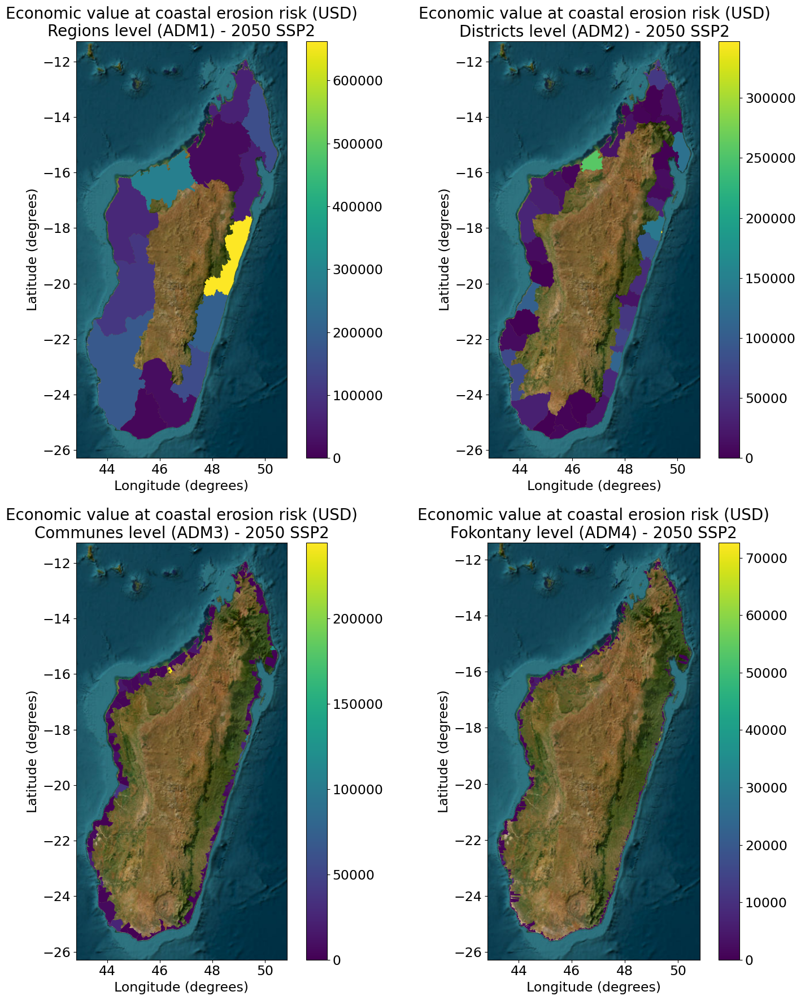

Economic value at coastal erosion risk (2050 - SSP5): 2163511.0 USD.


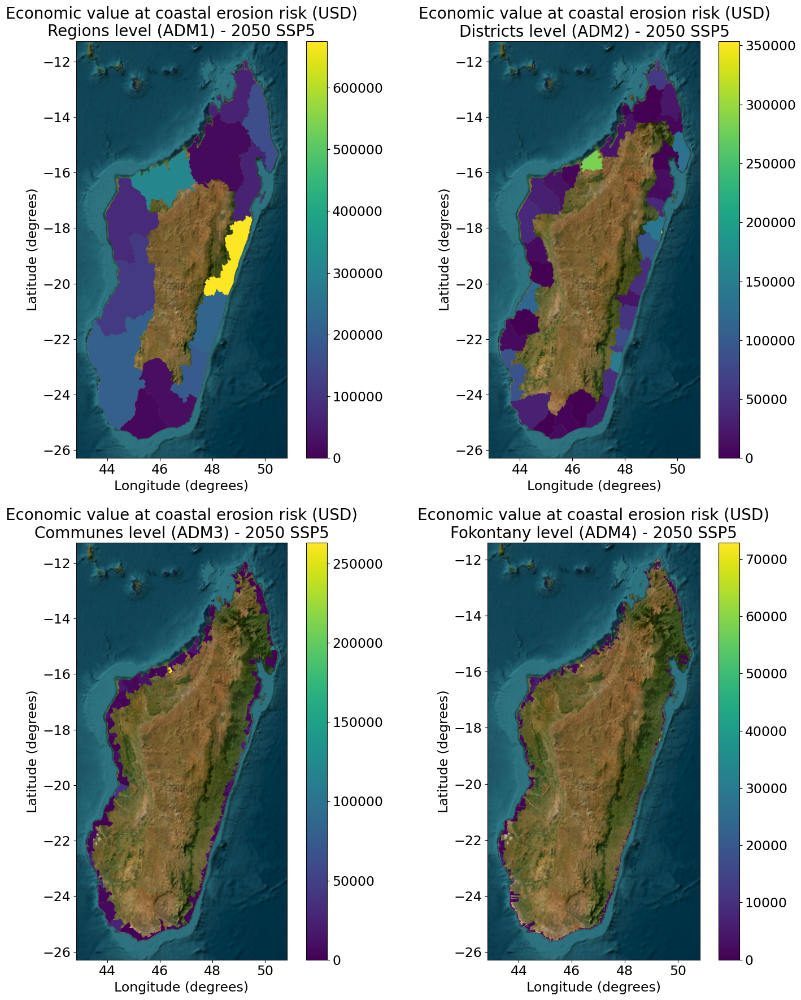

Economic value at coastal erosion risk (2085 - SSP2): 4086092.0 USD.


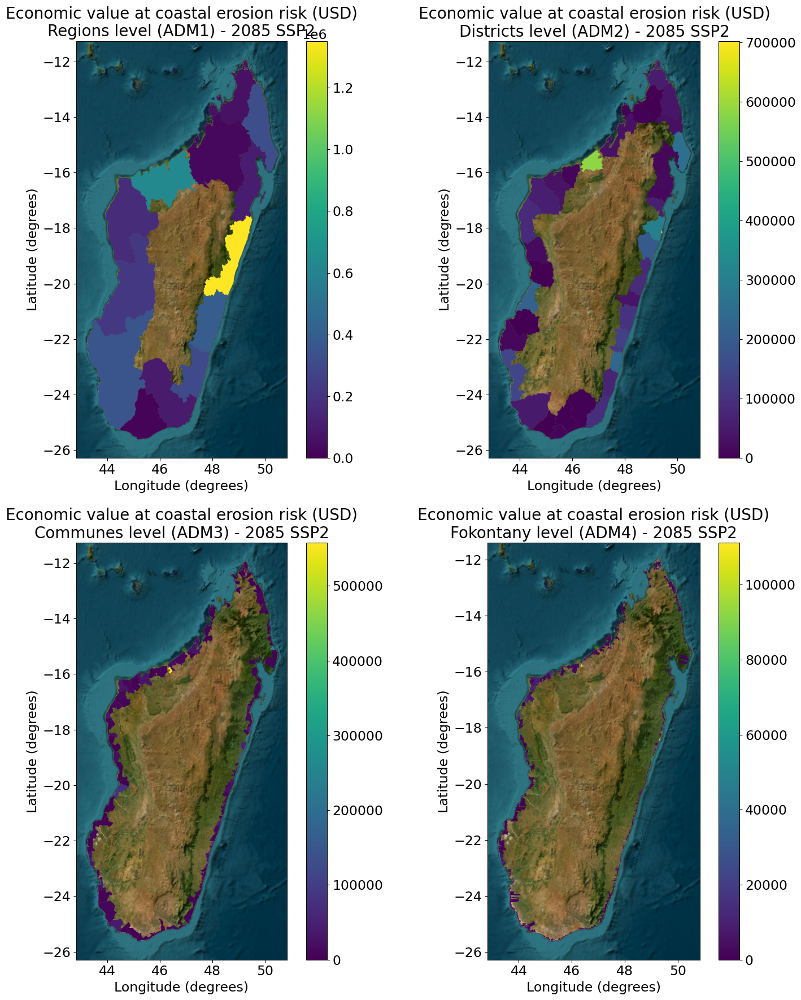

Economic value at coastal erosion risk (2085 - SSP5): 4977155.0 USD.


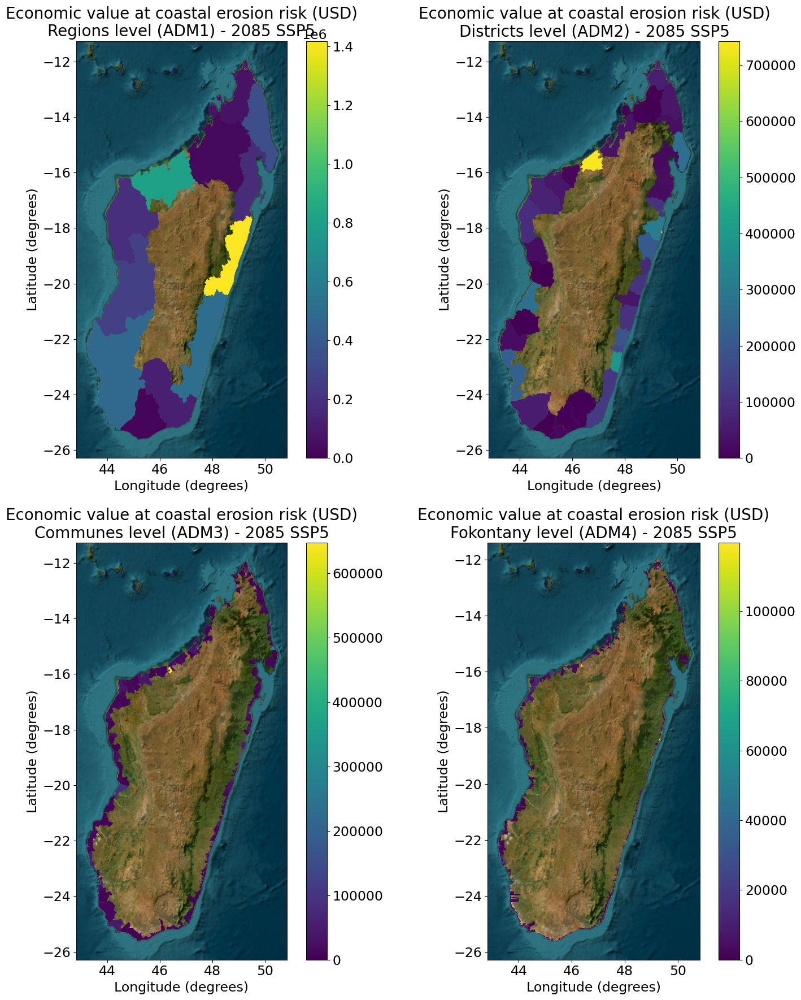

Economic value at coastal erosion risk (2100 - SSP2): 5021712.0 USD.


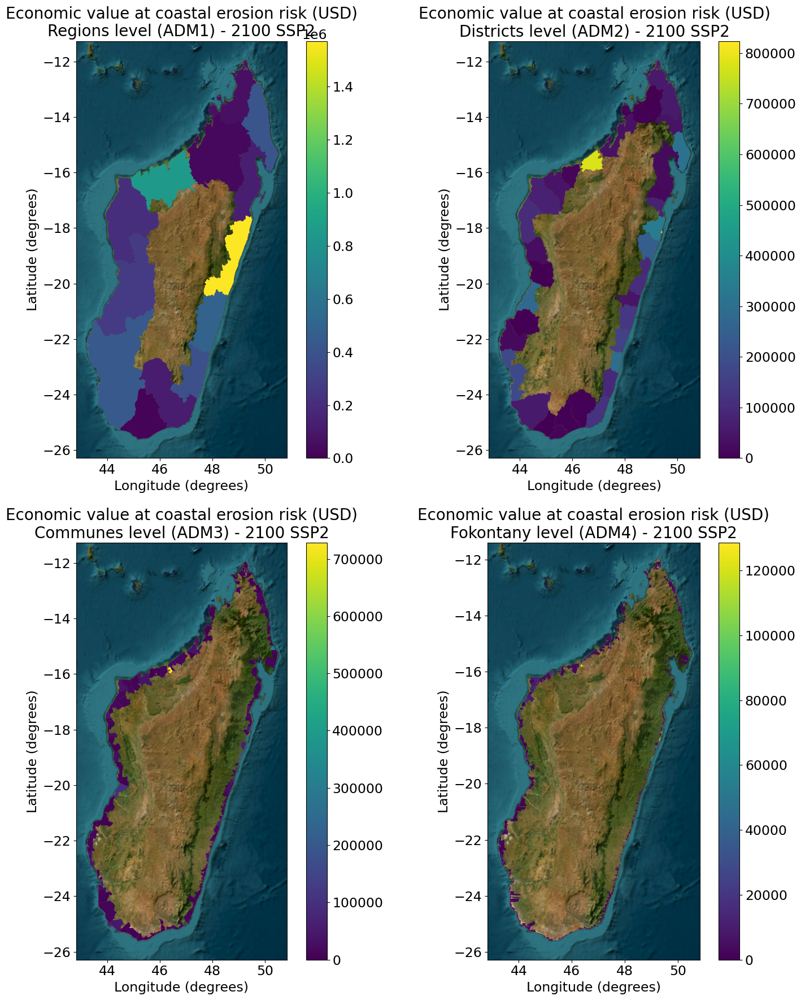

Economic value at coastal erosion risk (2100 - SSP5): 6254834.0 USD.


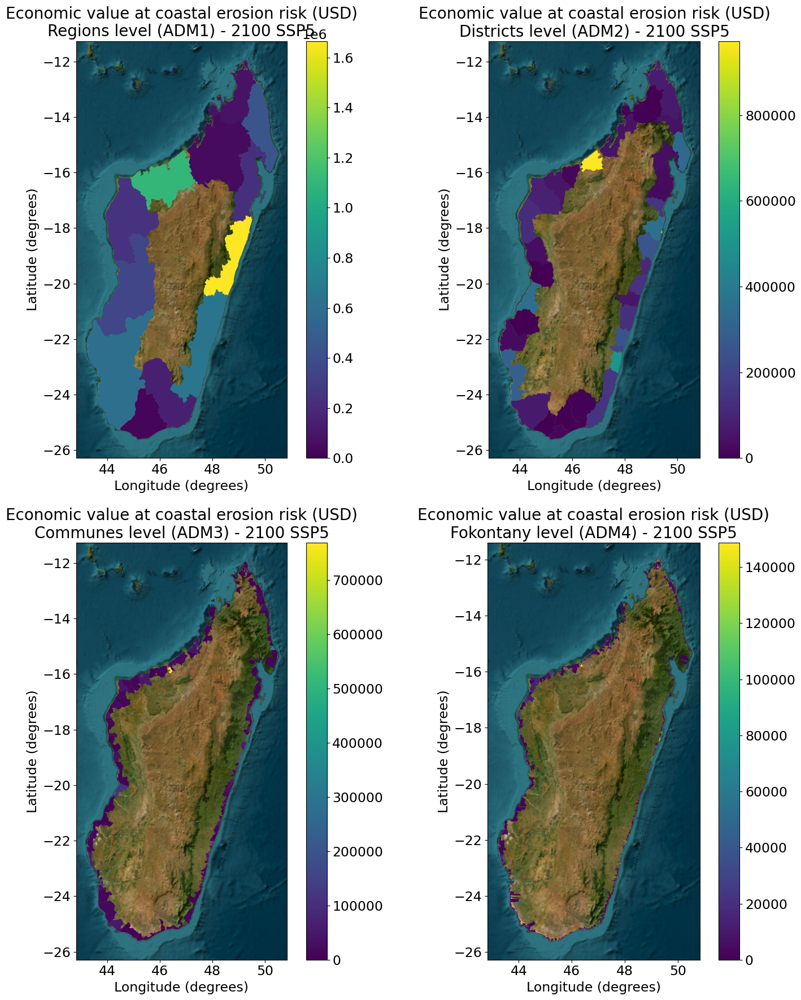

In [177]:
## Economic value at coastal erosion risk

# Step 1: Define the input table containing economic value data
tn_input_econ_value = 'econ_value_litpop'
# This variable holds the name of the table containing the economic value data (litpop) which will be used in subsequent functions.

# Step 2: Compute economic value affected by coastal erosion for all future scenarios
# This function calculates the economic value (in USD) that is at risk due to coastal erosion for each scenario.
# It processes the input table and generates summary statistics for each scenario.
compute_econ_value_eroded(tn_input_econ_value, scenarios, con)

# Step 3: Compute economic value affected by coastal erosion at various administrative levels
# This function aggregates the economic value erosion data at different administrative levels (adm0 to adm4).
# The function computes statistics for each administrative level and saves the results into separate tables.
compute_econ_value_eroded_adm(scenarios, con)

# Step 4: Add spatial geometries to economic value statistics by administrative level
# This function joins the economic value erosion statistics with spatial geometry data for each administrative level (adm0 to adm4).
# This is crucial for creating geospatial visualizations of the economic value at risk due to coastal erosion.
compute_econ_value_eroded_adm_geometries(scenarios, con)

# Step 5: Plot economic value at risk by administrative levels and save figures
# This function generates visualizations that show the economic value at risk for different administrative levels (adm0 to adm4).
# It saves the plots as PNG files in the specified directory (`fn_figures`).
plot_econ_value_eroded_adm(scenarios, fn_figures, con)

# Step 6: Plot economic value at risk for the entire country and save figures
# This function generates a plot displaying the total economic value at risk for the whole country (Madagascar) based on the scenarios.
# It saves the resulting plot as a PNG file in the specified directory (`fn_figures`).
plot_econ_value_eroded_country(scenarios, fn_figures, con)

# Step 7: Plot economic value at risk for the communes and save figures
# This function generates a visualization that focuses on the economic value at risk for the communes (adm3 level) in Madagascar.
# The function generates a plot and saves the result as a PNG file in the specified directory (`fn_figures`).
plot_econ_value_eroded_communes(scenarios, fn_figures, con)


# Save datasets to local

In [11]:
import os

# Define dataset names and descriptions
data = [
    # Polygons of Administrative boundaries
    ("mdg_adm1_geom", "Administrative boundaries (Level 1)"),
    ("mdg_adm2_geom", "Administrative boundaries (Level 2)"),
    ("mdg_adm3_geom", "Administrative boundaries (Level 3)"),
    ("mdg_adm4_geom", "Administrative boundaries (Level 4)"),
    ("madagascar_coastline_mainland", "Madagascar coastline"),

    # Coastal erosion points
    ("shd_ssp2_2050", "Coastal erosion hazard (LISCOAST, SSP2, 2050)"),
    ("shd_ssp5_2050", "Coastal erosion hazard (LISCOAST, SSP5, 2050)"),
    ("shd_ssp2_2085", "Coastal erosion hazard (LISCOAST, SSP2, 2085)"),
    ("shd_ssp5_2085", "Coastal erosion hazard (LISCOAST, SSP5, 2085)"),

    # Coastal erosion hazard (area eroded in km2)
    ("shd_ssp2_2050_pol", "Coastal erosion hazard (polygons, SSP2, 2050)"),
    ("shd_ssp5_2050_pol", "Coastal erosion hazard (polygons, SSP5, 2050)"),
    ("shd_ssp2_2085_pol", "Coastal erosion hazard (polygons, SSP2, 2085)"),
    ("shd_ssp5_2085_pol", "Coastal erosion hazard (polygons, SSP5, 2085)"),
    
    ("shd_ssp2_2050_pol_adm_stats_adm1", "Coastal erosion hazard (processed, SSP2, 2050, Admin 1)"),
    ("shd_ssp2_2050_pol_adm_stats_adm2", "Coastal erosion hazard (processed, SSP2, 2050, Admin 2)"),
    ("shd_ssp2_2050_pol_adm_stats_adm3", "Coastal erosion hazard (processed, SSP2, 2050, Admin 3)"),
    ("shd_ssp2_2050_pol_adm_stats_adm4", "Coastal erosion hazard (processed, SSP2, 2050, Admin 4)"),
    
    ("shd_ssp5_2050_pol_adm_stats_adm1", "Coastal erosion hazard (processed, SSP5, 2050, Admin 1)"),
    ("shd_ssp5_2050_pol_adm_stats_adm2", "Coastal erosion hazard (processed, SSP5, 2050, Admin 2)"),
    ("shd_ssp5_2050_pol_adm_stats_adm3", "Coastal erosion hazard (processed, SSP5, 2050, Admin 3)"),
    ("shd_ssp5_2050_pol_adm_stats_adm4", "Coastal erosion hazard (processed, SSP5, 2050, Admin 4)"),

    ("shd_ssp2_2085_pol_adm_stats_adm1", "Coastal erosion hazard (processed, SSP2, 2085, Admin 1)"),
    ("shd_ssp2_2085_pol_adm_stats_adm2", "Coastal erosion hazard (processed, SSP2, 2085, Admin 2)"),
    ("shd_ssp2_2085_pol_adm_stats_adm3", "Coastal erosion hazard (processed, SSP2, 2085, Admin 3)"),
    ("shd_ssp2_2085_pol_adm_stats_adm4", "Coastal erosion hazard (processed, SSP2, 2085, Admin 4)"),

    ("shd_ssp5_2085_pol_adm_stats_adm1", "Coastal erosion hazard (processed, SSP5, 2085, Admin 1)"),
    ("shd_ssp5_2085_pol_adm_stats_adm2", "Coastal erosion hazard (processed, SSP5, 2085, Admin 2)"),
    ("shd_ssp5_2085_pol_adm_stats_adm3", "Coastal erosion hazard (processed, SSP5, 2085, Admin 3)"),
    ("shd_ssp5_2085_pol_adm_stats_adm4", "Coastal erosion hazard (processed, SSP5, 2085, Admin 4)"),

    # Population Exposure (population per Administrative Boundary)
    ("population_worldpop_adm_stats_adm1", "Population exposure (Admin 1)"),
    ("population_worldpop_adm_stats_adm2", "Population exposure (Admin 2)"),
    ("population_worldpop_adm_stats_adm3", "Population exposure (Admin 3)"),
    ("population_worldpop_adm_stats_adm4", "Population exposure (Admin 4)"),

    # Economic Exposure (GDP in USD per Administrative Boundary)
    ("econ_value_litpop_adm_stats_adm1", "Economic value exposure (Admin 1)"),
    ("econ_value_litpop_adm_stats_adm2", "Economic value exposure (Admin 2)"),
    ("econ_value_litpop_adm_stats_adm3", "Economic value exposure (Admin 3)"),
    ("econ_value_litpop_adm_stats_adm4", "Economic value exposure (Admin 4)"),

    # Population at Risk (in number of people impacted)
    ("shd_ssp2_2050_pop_erosion", "Coastal erosion risk (Population, SSP2, 2050)"),
    ("shd_ssp5_2050_pop_erosion", "Coastal erosion risk (Population, SSP5, 2050)"),
    ("shd_ssp2_2085_pop_erosion", "Coastal erosion risk (Population, SSP2, 2085)"),
    ("shd_ssp5_2085_pop_erosion", "Coastal erosion risk (Population, SSP5, 2085)"),
    ("shd_ssp2_2050_econ_value_erosion", "Coastal erosion risk (Economic value, SSP2, 2050)"),
    ("shd_ssp5_2050_econ_value_erosion", "Coastal erosion risk (Economic value, SSP5, 2050)"),
    ("shd_ssp2_2085_econ_value_erosion", "Coastal erosion risk (Economic value, SSP2, 2085)"),
    ("shd_ssp5_2085_econ_value_erosion", "Coastal erosion risk (Economic value, SSP5, 2085)"),
    
    ("shd_ssp2_2050_pop_erosion_adm_stats_adm1", "Coastal erosion risk (Population, SSP2, 2050, Admin 1)"),
    ("shd_ssp2_2050_pop_erosion_adm_stats_adm2", "Coastal erosion risk (Population, SSP2, 2050, Admin 2)"),
    ("shd_ssp2_2050_pop_erosion_adm_stats_adm3", "Coastal erosion risk (Population, SSP2, 2050, Admin 3)"),
    ("shd_ssp2_2050_pop_erosion_adm_stats_adm4", "Coastal erosion risk (Population, SSP2, 2050, Admin 4)"),

    ("shd_ssp5_2050_pop_erosion_adm_stats_adm1", "Coastal erosion risk (Population, SSP5, 2050, Admin 1)"),
    ("shd_ssp5_2050_pop_erosion_adm_stats_adm2", "Coastal erosion risk (Population, SSP5, 2050, Admin 2)"),
    ("shd_ssp5_2050_pop_erosion_adm_stats_adm3", "Coastal erosion risk (Population, SSP5, 2050, Admin 3)"),
    ("shd_ssp5_2050_pop_erosion_adm_stats_adm4", "Coastal erosion risk (Population, SSP5, 2050, Admin 4)"),

    ("shd_ssp2_2085_pop_erosion_adm_stats_adm1", "Coastal erosion risk (Population, SSP2, 2085, Admin 1)"),
    ("shd_ssp2_2085_pop_erosion_adm_stats_adm2", "Coastal erosion risk (Population, SSP2, 2085, Admin 2)"),
    ("shd_ssp2_2085_pop_erosion_adm_stats_adm3", "Coastal erosion risk (Population, SSP2, 2085, Admin 3)"),
    ("shd_ssp2_2085_pop_erosion_adm_stats_adm4", "Coastal erosion risk (Population, SSP2, 2085, Admin 4)"),

    ("shd_ssp5_2085_pop_erosion_adm_stats_adm1", "Coastal erosion risk (Population, SSP5, 2085, Admin 1)"),
    ("shd_ssp5_2085_pop_erosion_adm_stats_adm2", "Coastal erosion risk (Population, SSP5, 2085, Admin 2)"),
    ("shd_ssp5_2085_pop_erosion_adm_stats_adm3", "Coastal erosion risk (Population, SSP5, 2085, Admin 3)"),
    ("shd_ssp5_2085_pop_erosion_adm_stats_adm4", "Coastal erosion risk (Population, SSP5, 2085, Admin 4)"),

    # Economic value at Risk (in GDP impacted, in USD)
    ("shd_ssp2_2050_econ_value_erosion_adm_stats_adm1", "Coastal erosion risk (Economic value, SSP2, 2050, Admin 1)"),
    ("shd_ssp2_2050_econ_value_erosion_adm_stats_adm2", "Coastal erosion risk (Economic value, SSP2, 2050, Admin 2)"),
    ("shd_ssp2_2050_econ_value_erosion_adm_stats_adm3", "Coastal erosion risk (Economic value, SSP2, 2050, Admin 3)"),
    ("shd_ssp2_2050_econ_value_erosion_adm_stats_adm4", "Coastal erosion risk (Economic value, SSP2, 2050, Admin 4)"),
    
    ("shd_ssp5_2050_econ_value_erosion_adm_stats_adm1", "Coastal erosion risk (Economic value, SSP5, 2050, Admin 1)"),
    ("shd_ssp5_2050_econ_value_erosion_adm_stats_adm2", "Coastal erosion risk (Economic value, SSP5, 2050, Admin 2)"),
    ("shd_ssp5_2050_econ_value_erosion_adm_stats_adm3", "Coastal erosion risk (Economic value, SSP5, 2050, Admin 3)"),
    ("shd_ssp5_2050_econ_value_erosion_adm_stats_adm4", "Coastal erosion risk (Economic value, SSP5, 2050, Admin 4)"),
    
    ("shd_ssp2_2085_econ_value_erosion_adm_stats_adm1", "Coastal erosion risk (Economic value, SSP2, 2085, Admin 1)"),
    ("shd_ssp2_2085_econ_value_erosion_adm_stats_adm2", "Coastal erosion risk (Economic value, SSP2, 2085, Admin 2)"),
    ("shd_ssp2_2085_econ_value_erosion_adm_stats_adm3", "Coastal erosion risk (Economic value, SSP2, 2085, Admin 3)"),
    ("shd_ssp2_2085_econ_value_erosion_adm_stats_adm4", "Coastal erosion risk (Economic value, SSP2, 2085, Admin 4)"),
    
    ("shd_ssp5_2085_econ_value_erosion_adm_stats_adm1", "Coastal erosion risk (Economic value, SSP5, 2085, Admin 1)"),
    ("shd_ssp5_2085_econ_value_erosion_adm_stats_adm2", "Coastal erosion risk (Economic value, SSP5, 2085, Admin 2)"),
    ("shd_ssp5_2085_econ_value_erosion_adm_stats_adm3", "Coastal erosion risk (Economic value, SSP5, 2085, Admin 3)"),
    ("shd_ssp5_2085_econ_value_erosion_adm_stats_adm4", "Coastal erosion risk (Economic value, SSP5, 2085, Admin 4)"),

]

# Create DataFrame
df = pd.DataFrame(data, columns=["Table name", "Description"])


dir_figs = '/Users/aprida/Desktop/figures_report_shp'
os.makedirs(dir_figs, exist_ok=True)

for t in df['Table name']:
    cmd = f"""
    ogr2ogr -f "ESRI Shapefile" {dir_figs}/{t}.shp PG:"dbname={dbname}" {t}
    """
    os.system(cmd)
    print(f'{t} is downloaded.')

mdg_adm1_geom is downloaded.
mdg_adm2_geom is downloaded.
mdg_adm3_geom is downloaded.
mdg_adm4_geom is downloaded.
madagascar_coastline_mainland is downloaded.


Warning 6: Normalized/laundered field name: 'GNS:id' to 'GNS_id'
Warning 6: Normalized/laundered field name: 'name:de' to 'name_de'
Warning 6: Normalized/laundered field name: 'name:en' to 'name_en'
Warning 6: Normalized/laundered field name: 'name:fr' to 'name_fr'
Warning 6: Normalized/laundered field name: 'description' to 'descriptio'
Warning 6: Normalized/laundered field name: 'admin_level' to 'admin_leve'
Warning 6: Normalized/laundered field name: 'name:swb' to 'name_swb'
Warning 6: Normalized/laundered field name: 'alt_name:fr' to 'alt_name_f'
Warning 6: Normalized/laundered field name: 'name:ar' to 'name_ar'
Warning 6: Normalized/laundered field name: 'ref:FR:FANTOIR' to 'ref_FR_FAN'
Warning 6: Normalized/laundered field name: 'is_mainland' to 'is_mainlan'
Warning 1: Value '[2091172494, 6776247913, 6776247912, 6776247911, 6457423390, 2091172473, 6457423391, 111545114, 6457423392, 6776247910, 112423057, 6776247909, 6457423394, 6776247908, 6457423393, 6457423397, 6776247907, 6776

shd_ssp2_2050 is downloaded.


Warning 6: Normalized/laundered field name: 'is_mainland' to 'is_mainlan'


shd_ssp5_2050 is downloaded.


Warning 6: Normalized/laundered field name: 'is_mainland' to 'is_mainlan'


shd_ssp2_2085 is downloaded.


Warning 6: Normalized/laundered field name: 'is_mainland' to 'is_mainlan'


shd_ssp5_2085 is downloaded.
shd_ssp2_2050_pol is downloaded.
shd_ssp5_2050_pol is downloaded.
shd_ssp2_2085_pol is downloaded.
shd_ssp5_2085_pol is downloaded.


Warning 6: Normalized/laundered field name: 'area_erosion' to 'area_erosi'


shd_ssp2_2050_pol_adm_stats_adm1 is downloaded.


Warning 6: Normalized/laundered field name: 'area_erosion' to 'area_erosi'


shd_ssp2_2050_pol_adm_stats_adm2 is downloaded.


Warning 6: Normalized/laundered field name: 'area_erosion' to 'area_erosi'


shd_ssp2_2050_pol_adm_stats_adm3 is downloaded.
shd_ssp2_2050_pol_adm_stats_adm4 is downloaded.


Warning 6: Normalized/laundered field name: 'area_erosion' to 'area_erosi'
Warning 6: Normalized/laundered field name: 'area_erosion' to 'area_erosi'


shd_ssp5_2050_pol_adm_stats_adm1 is downloaded.


Warning 6: Normalized/laundered field name: 'area_erosion' to 'area_erosi'


shd_ssp5_2050_pol_adm_stats_adm2 is downloaded.
shd_ssp5_2050_pol_adm_stats_adm3 is downloaded.


Warning 6: Normalized/laundered field name: 'area_erosion' to 'area_erosi'
Warning 6: Normalized/laundered field name: 'area_erosion' to 'area_erosi'
Warning 6: Normalized/laundered field name: 'area_erosion' to 'area_erosi'


shd_ssp5_2050_pol_adm_stats_adm4 is downloaded.
shd_ssp2_2085_pol_adm_stats_adm1 is downloaded.


Warning 6: Normalized/laundered field name: 'area_erosion' to 'area_erosi'


shd_ssp2_2085_pol_adm_stats_adm2 is downloaded.


Warning 6: Normalized/laundered field name: 'area_erosion' to 'area_erosi'


shd_ssp2_2085_pol_adm_stats_adm3 is downloaded.
shd_ssp2_2085_pol_adm_stats_adm4 is downloaded.


Warning 6: Normalized/laundered field name: 'area_erosion' to 'area_erosi'
Warning 6: Normalized/laundered field name: 'area_erosion' to 'area_erosi'


shd_ssp5_2085_pol_adm_stats_adm1 is downloaded.


Warning 6: Normalized/laundered field name: 'area_erosion' to 'area_erosi'


shd_ssp5_2085_pol_adm_stats_adm2 is downloaded.


Warning 6: Normalized/laundered field name: 'area_erosion' to 'area_erosi'


shd_ssp5_2085_pol_adm_stats_adm3 is downloaded.


Warning 6: Normalized/laundered field name: 'area_erosion' to 'area_erosi'
Warning 6: Normalized/laundered field name: 'weighted_pop' to 'weighted_p'


shd_ssp5_2085_pol_adm_stats_adm4 is downloaded.
population_worldpop_adm_stats_adm1 is downloaded.


Warning 6: Normalized/laundered field name: 'weighted_pop' to 'weighted_p'


population_worldpop_adm_stats_adm2 is downloaded.


Warning 6: Normalized/laundered field name: 'weighted_pop' to 'weighted_p'


population_worldpop_adm_stats_adm3 is downloaded.


Warning 6: Normalized/laundered field name: 'weighted_pop' to 'weighted_p'


population_worldpop_adm_stats_adm4 is downloaded.


Warning 6: Normalized/laundered field name: 'weighted_pop' to 'weighted_p'
Warning 1: Value 301114160 of field weighted_p of feature 0 not successfully written. Possibly due to too larger number with respect to field width
Warning 1: Value 783028015 of field weighted_p of feature 1 not successfully written. Possibly due to too larger number with respect to field width
Warning 1: Value 565681815 of field weighted_p of feature 2 not successfully written. Possibly due to too larger number with respect to field width
Warning 1: Value 331282394 of field weighted_p of feature 3 not successfully written. Possibly due to too larger number with respect to field width
Warning 1: Value 769578962 of field weighted_p of feature 4 not successfully written. Possibly due to too larger number with respect to field width
Warning 1: Value 880069251 of field weighted_p of feature 5 not successfully written. Possibly due to too larger number with respect to field width
Warning 1: Value 347241206 of field w

econ_value_litpop_adm_stats_adm1 is downloaded.


Warning 6: Normalized/laundered field name: 'weighted_pop' to 'weighted_p'
Warning 1: Value 122039723 of field weighted_p of feature 2 not successfully written. Possibly due to too larger number with respect to field width
Warning 1: Value 117296036 of field weighted_p of feature 3 not successfully written. Possibly due to too larger number with respect to field width
Warning 1: Value 257548525 of field weighted_p of feature 8 not successfully written. Possibly due to too larger number with respect to field width
Warning 1: Value 279622210 of field weighted_p of feature 10 not successfully written. Possibly due to too larger number with respect to field width
Warning 1: Value 303798663 of field weighted_p of feature 12 not successfully written. Possibly due to too larger number with respect to field width
Warning 1: Value 190595166 of field weighted_p of feature 13 not successfully written. Possibly due to too larger number with respect to field width
Warning 1: Value 295314763 of fiel

econ_value_litpop_adm_stats_adm2 is downloaded.


Warning 6: Normalized/laundered field name: 'weighted_pop' to 'weighted_p'
Warning 1: Value 114624781 of field weighted_p of feature 81 not successfully written. Possibly due to too larger number with respect to field width
Warning 1: Value 196685791 of field weighted_p of feature 87 not successfully written. Possibly due to too larger number with respect to field width
Warning 1: Value 193032722 of field weighted_p of feature 114 not successfully written. Possibly due to too larger number with respect to field width
Warning 1: Value 118159004 of field weighted_p of feature 812 not successfully written. Possibly due to too larger number with respect to field width
Warning 1: Value 121619708 of field weighted_p of feature 880 not successfully written. Possibly due to too larger number with respect to field width
Warning 1: Value 110182068 of field weighted_p of feature 899 not successfully written. Possibly due to too larger number with respect to field width


econ_value_litpop_adm_stats_adm3 is downloaded.


Warning 6: Normalized/laundered field name: 'weighted_pop' to 'weighted_p'


econ_value_litpop_adm_stats_adm4 is downloaded.
shd_ssp2_2050_pop_erosion is downloaded.


Warning 6: Normalized/laundered field name: 'area_sqm_erosion' to 'area_sqm_e'
Warning 6: Normalized/laundered field name: 'val_erosion' to 'val_erosio'
Warning 6: Normalized/laundered field name: 'area_sqm_erosion' to 'area_sqm_e'
Warning 6: Normalized/laundered field name: 'val_erosion' to 'val_erosio'
Warning 6: Normalized/laundered field name: 'area_sqm_erosion' to 'area_sqm_e'
Warning 6: Normalized/laundered field name: 'val_erosion' to 'val_erosio'


shd_ssp5_2050_pop_erosion is downloaded.
shd_ssp2_2085_pop_erosion is downloaded.


Warning 6: Normalized/laundered field name: 'area_sqm_erosion' to 'area_sqm_e'
Warning 6: Normalized/laundered field name: 'val_erosion' to 'val_erosio'


shd_ssp5_2085_pop_erosion is downloaded.


Warning 6: Normalized/laundered field name: 'area_sqm_erosion' to 'area_sqm_e'
Warning 6: Normalized/laundered field name: 'val_erosion' to 'val_erosio'


shd_ssp2_2050_econ_value_erosion is downloaded.


Warning 6: Normalized/laundered field name: 'area_sqm_erosion' to 'area_sqm_e'
Warning 6: Normalized/laundered field name: 'val_erosion' to 'val_erosio'


shd_ssp5_2050_econ_value_erosion is downloaded.


Warning 6: Normalized/laundered field name: 'area_sqm_erosion' to 'area_sqm_e'
Warning 6: Normalized/laundered field name: 'val_erosion' to 'val_erosio'


shd_ssp2_2085_econ_value_erosion is downloaded.


Warning 6: Normalized/laundered field name: 'area_sqm_erosion' to 'area_sqm_e'
Warning 6: Normalized/laundered field name: 'val_erosion' to 'val_erosio'


shd_ssp5_2085_econ_value_erosion is downloaded.


Warning 6: Normalized/laundered field name: 'weighted_pop' to 'weighted_p'


shd_ssp2_2050_pop_erosion_adm_stats_adm1 is downloaded.


Warning 6: Normalized/laundered field name: 'weighted_pop' to 'weighted_p'


shd_ssp2_2050_pop_erosion_adm_stats_adm2 is downloaded.
shd_ssp2_2050_pop_erosion_adm_stats_adm3 is downloaded.


Warning 6: Normalized/laundered field name: 'weighted_pop' to 'weighted_p'
Warning 6: Normalized/laundered field name: 'weighted_pop' to 'weighted_p'


shd_ssp2_2050_pop_erosion_adm_stats_adm4 is downloaded.


Warning 6: Normalized/laundered field name: 'weighted_pop' to 'weighted_p'


shd_ssp5_2050_pop_erosion_adm_stats_adm1 is downloaded.


Warning 6: Normalized/laundered field name: 'weighted_pop' to 'weighted_p'


shd_ssp5_2050_pop_erosion_adm_stats_adm2 is downloaded.


Warning 6: Normalized/laundered field name: 'weighted_pop' to 'weighted_p'
Warning 6: Normalized/laundered field name: 'weighted_pop' to 'weighted_p'


shd_ssp5_2050_pop_erosion_adm_stats_adm3 is downloaded.
shd_ssp5_2050_pop_erosion_adm_stats_adm4 is downloaded.


Warning 6: Normalized/laundered field name: 'weighted_pop' to 'weighted_p'


shd_ssp2_2085_pop_erosion_adm_stats_adm1 is downloaded.


Warning 6: Normalized/laundered field name: 'weighted_pop' to 'weighted_p'


shd_ssp2_2085_pop_erosion_adm_stats_adm2 is downloaded.
shd_ssp2_2085_pop_erosion_adm_stats_adm3 is downloaded.


Warning 6: Normalized/laundered field name: 'weighted_pop' to 'weighted_p'
Warning 6: Normalized/laundered field name: 'weighted_pop' to 'weighted_p'


shd_ssp2_2085_pop_erosion_adm_stats_adm4 is downloaded.


Warning 6: Normalized/laundered field name: 'weighted_pop' to 'weighted_p'


shd_ssp5_2085_pop_erosion_adm_stats_adm1 is downloaded.


Warning 6: Normalized/laundered field name: 'weighted_pop' to 'weighted_p'


shd_ssp5_2085_pop_erosion_adm_stats_adm2 is downloaded.
shd_ssp5_2085_pop_erosion_adm_stats_adm3 is downloaded.


Warning 6: Normalized/laundered field name: 'weighted_pop' to 'weighted_p'
Warning 6: Normalized/laundered field name: 'weighted_pop' to 'weighted_p'


shd_ssp5_2085_pop_erosion_adm_stats_adm4 is downloaded.


Warning 6: Normalized/laundered field name: 'weighted_pop' to 'weighted_p'


shd_ssp2_2050_econ_value_erosion_adm_stats_adm1 is downloaded.


Warning 6: Normalized/laundered field name: 'weighted_pop' to 'weighted_p'


shd_ssp2_2050_econ_value_erosion_adm_stats_adm2 is downloaded.


Warning 6: Normalized/laundered field name: 'weighted_pop' to 'weighted_p'


shd_ssp2_2050_econ_value_erosion_adm_stats_adm3 is downloaded.


Warning 6: Normalized/laundered field name: 'weighted_pop' to 'weighted_p'


shd_ssp2_2050_econ_value_erosion_adm_stats_adm4 is downloaded.


Warning 6: Normalized/laundered field name: 'weighted_pop' to 'weighted_p'


shd_ssp5_2050_econ_value_erosion_adm_stats_adm1 is downloaded.


Warning 6: Normalized/laundered field name: 'weighted_pop' to 'weighted_p'


shd_ssp5_2050_econ_value_erosion_adm_stats_adm2 is downloaded.


Warning 6: Normalized/laundered field name: 'weighted_pop' to 'weighted_p'


shd_ssp5_2050_econ_value_erosion_adm_stats_adm3 is downloaded.
shd_ssp5_2050_econ_value_erosion_adm_stats_adm4 is downloaded.


Warning 6: Normalized/laundered field name: 'weighted_pop' to 'weighted_p'
Warning 6: Normalized/laundered field name: 'weighted_pop' to 'weighted_p'


shd_ssp2_2085_econ_value_erosion_adm_stats_adm1 is downloaded.


Warning 6: Normalized/laundered field name: 'weighted_pop' to 'weighted_p'


shd_ssp2_2085_econ_value_erosion_adm_stats_adm2 is downloaded.


Warning 6: Normalized/laundered field name: 'weighted_pop' to 'weighted_p'


shd_ssp2_2085_econ_value_erosion_adm_stats_adm3 is downloaded.


Warning 6: Normalized/laundered field name: 'weighted_pop' to 'weighted_p'
Warning 6: Normalized/laundered field name: 'weighted_pop' to 'weighted_p'


shd_ssp2_2085_econ_value_erosion_adm_stats_adm4 is downloaded.
shd_ssp5_2085_econ_value_erosion_adm_stats_adm1 is downloaded.


Warning 6: Normalized/laundered field name: 'weighted_pop' to 'weighted_p'


shd_ssp5_2085_econ_value_erosion_adm_stats_adm2 is downloaded.


Warning 6: Normalized/laundered field name: 'weighted_pop' to 'weighted_p'


shd_ssp5_2085_econ_value_erosion_adm_stats_adm3 is downloaded.
shd_ssp5_2085_econ_value_erosion_adm_stats_adm4 is downloaded.


Warning 6: Normalized/laundered field name: 'weighted_pop' to 'weighted_p'


In [10]:
df.to_excel(f"{root}/erosion/madagascar_datasets.xlsx", index=False)